# UMAPs Neurips samples, NK cells

Surface markers + respective RNA

- CLR normalized data

### Reference 4: #

Yang, C., Siebert, J. R., Burns, R., Gerbec, Z. J., Bonacci, B., Rymaszewski, A., Rau, M., Riese, M. J., Rao, S., Carlson, K. S., Routes, J. M., Verbsky, J. W., Thakar, M. S., & Malarkannan, S. (2019). Heterogeneity of human bone marrow and blood natural killer cells defined by single-cell transcriptome. Nature communications, 10(1), 3931. https://doi.org/10.1038/s41467-019-11947-7


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import anndata as ad
import scvi
import scanpy as sc
import umap

from ridgeplot import ridgeplot

import warnings

warnings.filterwarnings('ignore')



Global seed set to 0
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)


In [6]:
#Neurips
adata_neurips = sc.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/adata_neurips_norm_outer.h5ad')

In [7]:
adata_neurips

AnnData object with n_obs × n_vars = 80998 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS'
    obsm: 'ADT_X_pca', 'ADT_X_umap', 'ADT_isotype_controls', 'GEX_X_pca', 'GEX_X_umap', 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_neurips'
    layers: 'counts'

In [8]:
#To find gene names

result = [i for i in adata_neurips.var_names if i.startswith('TC')]
print(result)

['TC2N', 'TCAF1', 'TCAF2', 'TCAIM', 'TCAP', 'TCEA1', 'TCEA2', 'TCEA3', 'TCEAL1', 'TCEAL2', 'TCEAL3', 'TCEAL4', 'TCEAL5', 'TCEAL7', 'TCEAL8', 'TCEAL9', 'TCEANC', 'TCEANC2', 'TCEB1', 'TCEB2', 'TCEB3', 'TCEB3-AS1', 'TCERG1', 'TCF12', 'TCF15', 'TCF19', 'TCF20', 'TCF23', 'TCF25', 'TCF3', 'TCF4', 'TCF4-AS2', 'TCF7', 'TCF7L1', 'TCF7L2', 'TCFL5', 'TCHH', 'TCHP', 'TCIRG1', 'TCL1A', 'TCL1B', 'TCL6', 'TCN2', 'TCOF1', 'TCP1', 'TCP10L', 'TCP11', 'TCP11L1', 'TCP11L2', 'TCTA', 'TCTE1', 'TCTE3', 'TCTEX1D1', 'TCTEX1D2', 'TCTEX1D4', 'TCTN1', 'TCTN2', 'TCTN3']


In [9]:
adata_neurips.obs['cell_type'].unique().tolist()

['NK',
 'CD8+ T CD69+ CD45RA+',
 'NK CD158e1+',
 'HSC',
 'CD14+ Mono',
 'B1 B IGKC+',
 'CD4+ T activated',
 'CD8+ T CD69+ CD45RO+',
 'G/M prog',
 'Naive CD20+ B IGKC-',
 'CD8+ T CD49f+',
 'Naive CD20+ B IGKC+',
 'CD4+ T naive',
 'CD8+ T naive',
 'CD4+ T activated integrinB7+',
 'cDC2',
 'gdT TCRVD2+',
 'CD8+ T TIGIT+ CD45RO+',
 'CD16+ Mono',
 'Erythroblast',
 'MAIT',
 'T reg',
 'gdT CD158b+',
 'Transitional B',
 'Proerythroblast',
 'CD8+ T CD57+ CD45RO+',
 'Plasmablast IGKC+',
 'ILC1',
 'Lymph prog',
 'ILC',
 'MK/E prog',
 'Normoblast',
 'CD8+ T CD57+ CD45RA+',
 'pDC',
 'B1 B IGKC-',
 'Plasma cell IGKC-',
 'Plasmablast IGKC-',
 'Plasma cell IGKC+',
 'CD8+ T TIGIT+ CD45RA+',
 'CD8+ T naive CD127+ CD26- CD101-',
 'CD4+ T CD314+ CD45RA+',
 'cDC1',
 'T prog cycling',
 'dnT']

In [10]:
#Both NK cell types selected


neurips_nk = adata_neurips[(adata_neurips.obs['cell_type'] == "NK") | (adata_neurips.obs['cell_type'] == "NK CD158e1+")]

In [11]:
neurips_nk

View of AnnData object with n_obs × n_vars = 7388 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS'
    obsm: 'ADT_X_pca', 'ADT_X_umap', 'ADT_isotype_controls', 'GEX_X_pca', 'GEX_X_umap', 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_neurips'
    layers: 'counts'

In [12]:
neurips_nk_prot=neurips_nk.obsm['protein_expression_clr_neurips']

In [13]:
#To exclude columns that contain only zeros

neurips_nk_prot = pd.DataFrame(neurips_nk_prot)
neurips_nk_prot != 0
(neurips_nk_prot != 0).any(axis=0)
neurips_nk_prot.loc[:, (neurips_nk_prot != 0).any(axis=0)]
neurips_nk_prot = neurips_nk_prot.loc[:, (neurips_nk_prot != 0).any(axis=0)]

In [14]:
samples=adata_neurips.obs['POOL'].unique().tolist()

In [15]:
#selecting one sample from Neurips

eg=adata_neurips[adata_neurips.obs['POOL'] == "s4d1"]


In [16]:
eg

View of AnnData object with n_obs × n_vars = 4885 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS'
    obsm: 'ADT_X_pca', 'ADT_X_umap', 'ADT_isotype_controls', 'GEX_X_pca', 'GEX_X_umap', 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_neurips'
    layers: 'counts'

In [17]:
prot=eg.obsm['protein_expression_clr_neurips']

In [18]:
prot

,CD86,CD274,CD270,CD155,CD112,CD47,CD48,CD40,CD154,CD52,...,HLA-E,CD82,CD101,CD88,CD224,CD197,CD34,CD10,CD90,CD15
GTAGTACCAATCCTTT-1-s4d1,0.652674,1.447594,1.489354,0.890243,1.290341,1.988618,1.733474,0.850004,1.531390,0.694828,...,1.532575,0.614600,0.900688,1.389844,0.918109,0.0,0.0,0.0,0.0,0.0
CTCAAGAGTCACAGAG-1-s4d1,0.652674,1.069339,1.657770,0.890243,1.377072,1.264995,1.863027,1.101769,1.562259,1.072649,...,1.283465,0.614600,1.786480,0.762359,1.112478,0.0,0.0,0.0,0.0,0.0
CTGTGGGTCATGCGGC-1-s4d1,0.378666,1.132949,1.153412,0.730824,1.195368,1.546005,1.090567,1.173337,1.303511,1.013739,...,1.344431,0.353792,0.860303,0.979461,1.147198,0.0,0.0,0.0,0.0,0.0
CGTGATAGTTATCTGG-1-s4d1,0.000000,1.249182,1.335424,1.256332,2.674106,1.322314,0.289336,1.240123,1.397398,1.525053,...,0.859205,1.527772,0.629556,0.854928,1.000442,0.0,0.0,0.0,0.0,0.0
AGATCCAAGATCGGTG-1-s4d1,2.784459,1.132949,1.674846,1.669058,1.663981,2.101246,2.112640,1.417276,1.884321,1.861734,...,1.429432,1.031029,2.808629,2.007436,2.064066,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TAGATCGTCTCTATAC-1-s4d1,0.000000,1.132949,1.358918,1.523729,1.195368,1.312986,1.077960,1.173337,1.690467,1.013739,...,1.482333,0.353792,0.576253,1.157734,1.304730,0.0,0.0,0.0,0.0,0.0
AAGACTCAGGGCAAGG-1-s4d1,0.652674,1.302596,1.208881,0.541080,1.090419,1.589583,1.436578,1.240123,1.379313,0.561056,...,1.149104,0.614600,0.818218,1.189870,1.180752,0.0,0.0,0.0,0.0,0.0
CGAGAAGCACCTCGTT-1-s4d1,0.378666,0.764571,1.208881,0.730824,1.494512,1.944753,2.308527,0.941152,1.342130,1.231042,...,1.184424,0.773465,0.939506,1.017749,1.112478,0.0,0.0,0.0,0.0,0.0
TATCCTAGTTCTCCTG-1-s4d1,0.000000,1.302596,1.286711,0.890243,1.377072,1.150531,0.882414,1.469979,1.649530,0.607664,...,1.401893,1.405442,0.860303,1.124532,1.304730,0.0,0.0,0.0,0.0,0.0


In [19]:
prot=prot.rename(columns={'CD2': 'CD2_prot', 'CX3CR1': 'CX3CR1_prot', 'CD52': 'CD52_prot','CD69': 'CD69_prot', 'CD226':'CD226_prot', 'TIGIT':'TIGIT_prot', 'CD27':'CD27_prot', 'CD38': 'CD38_prot', 'CD224': 'CD224_prot', 'CD7': 'CD7_prot', 'CD44': 'CD44_prot', 'CD34': 'CD34_prot','CD5': 'CD5_prot'})


In [20]:
#some proteins and genes have same names, here _prot added after protein names

a = eg.obs
b = prot

adata_eg=pd.concat([a, b], axis=1)
eg.obs=adata_eg



In [21]:
#selecting NK cells, gd T cells and ILCs

sample_nk = eg[(eg.obs['cell_type'] == "NK") | (eg.obs['cell_type'] == "NK CD158e1+") | (eg.obs['cell_type'] == "ILC")] # | (eg.obs['cell_type'] == "gdT CD158b+")]   


In [22]:
#Computing a neighborhood of observations using latent space

sc.pp.neighbors(adata_neurips, use_rep="X_totalVI")   #indicated representation

sc.tl.umap(adata_neurips)

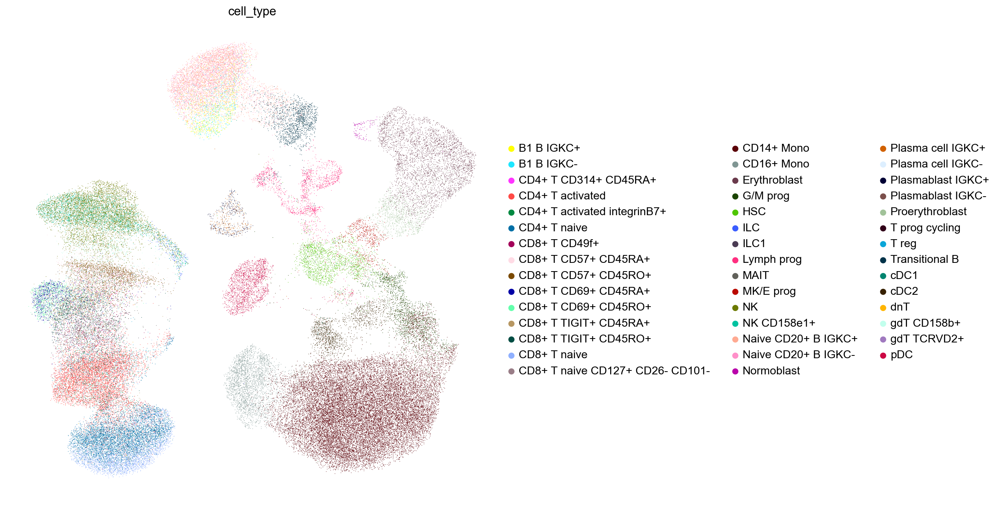

In [23]:
#Whole Neurips dataset, coloured by annotated cell types

sc.set_figure_params(figsize=(10, 10))

sc.pl.umap(adata_neurips, color = ['cell_type'], frameon = False)

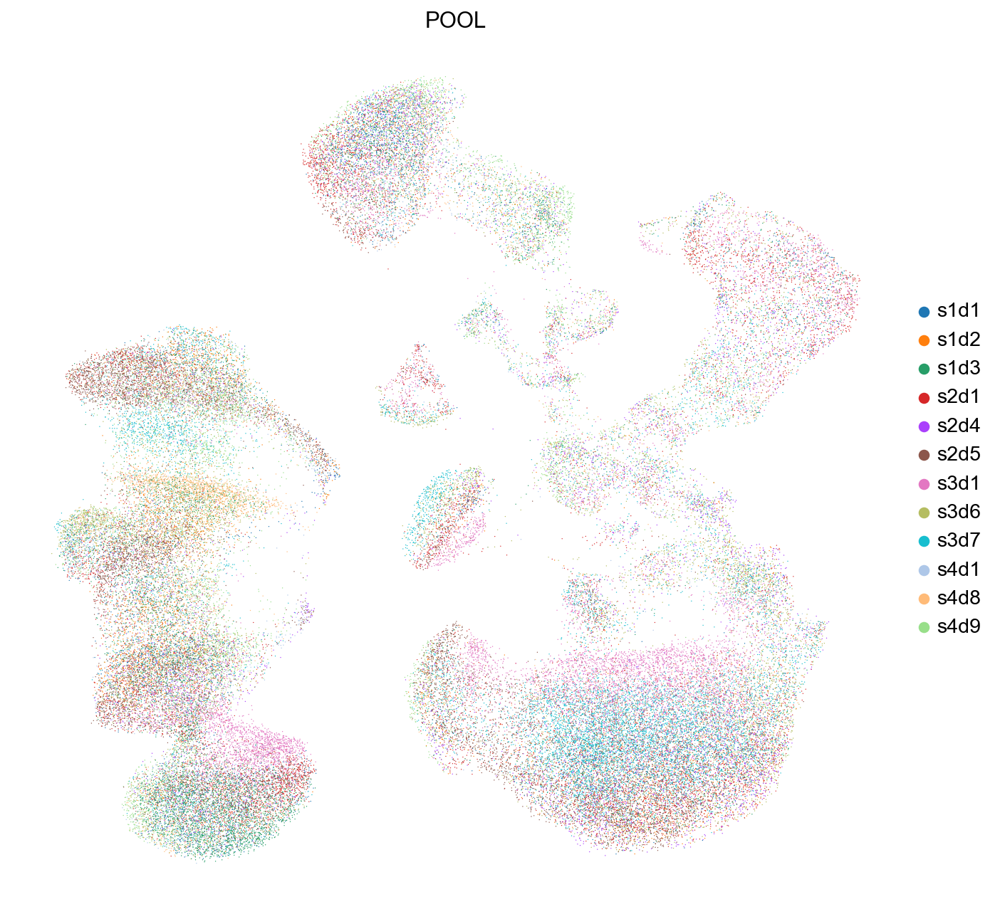

In [24]:
#Whole neurips dataset, coloured by samples

sc.pl.umap(adata_neurips, color = ['POOL'], frameon = False)

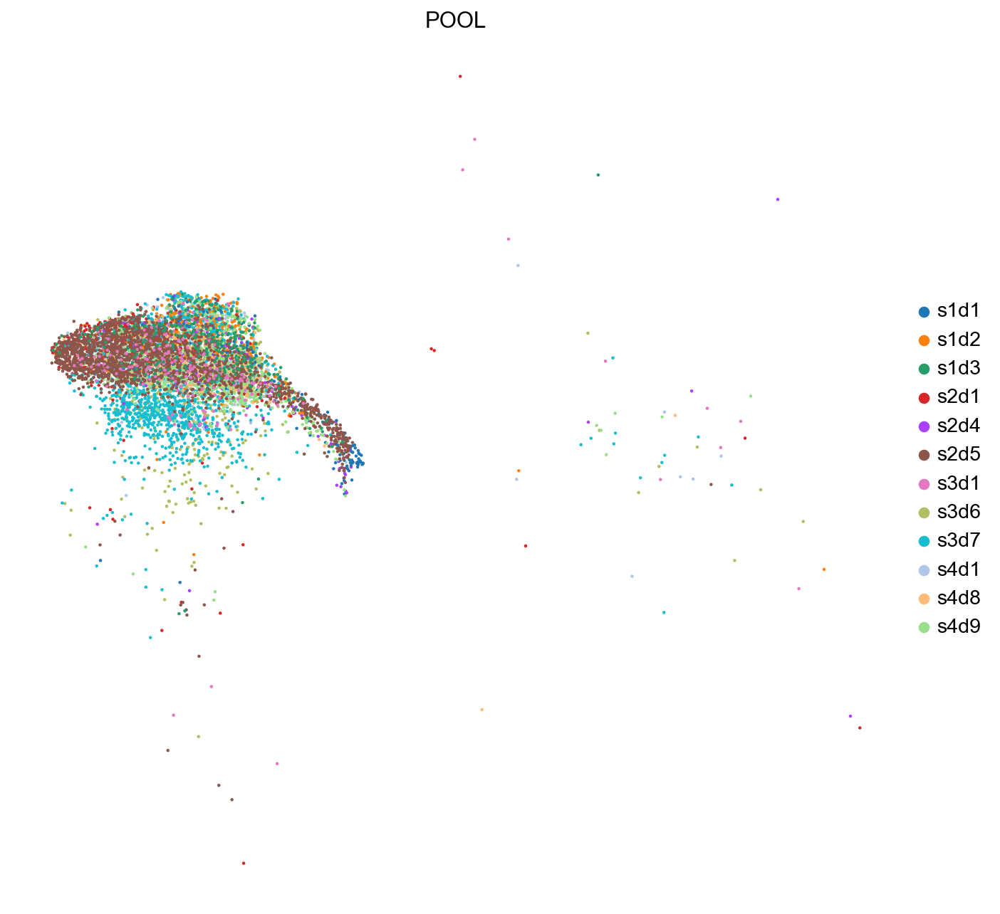

In [25]:
#All samples, but only selected cell types (NK, ILC and gd T cells)

sc.pl.umap(neurips_nk, color = ['POOL'], frameon = False)

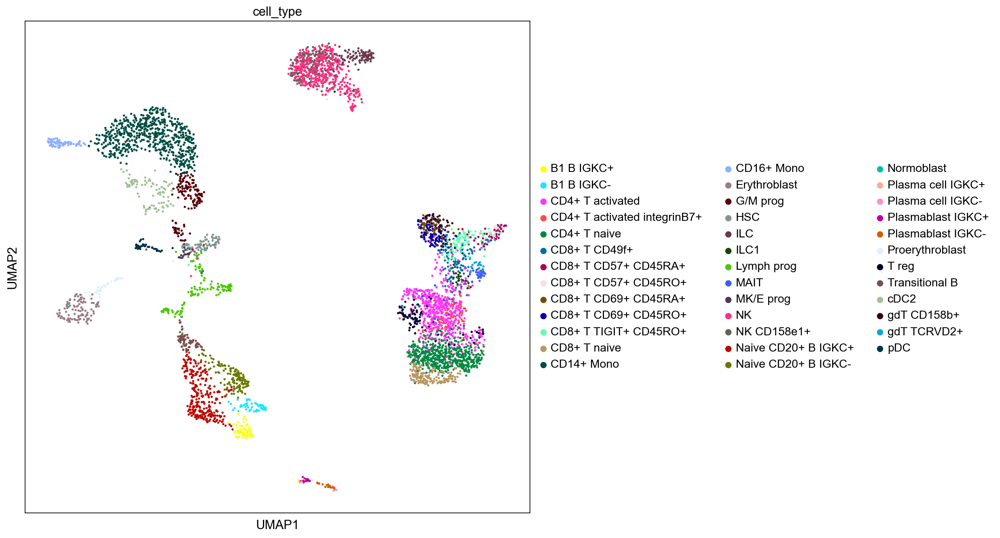

In [26]:
#only one sample

sc.set_figure_params(figsize=(10, 10))

sc.pl.umap(eg, color = ['cell_type'])

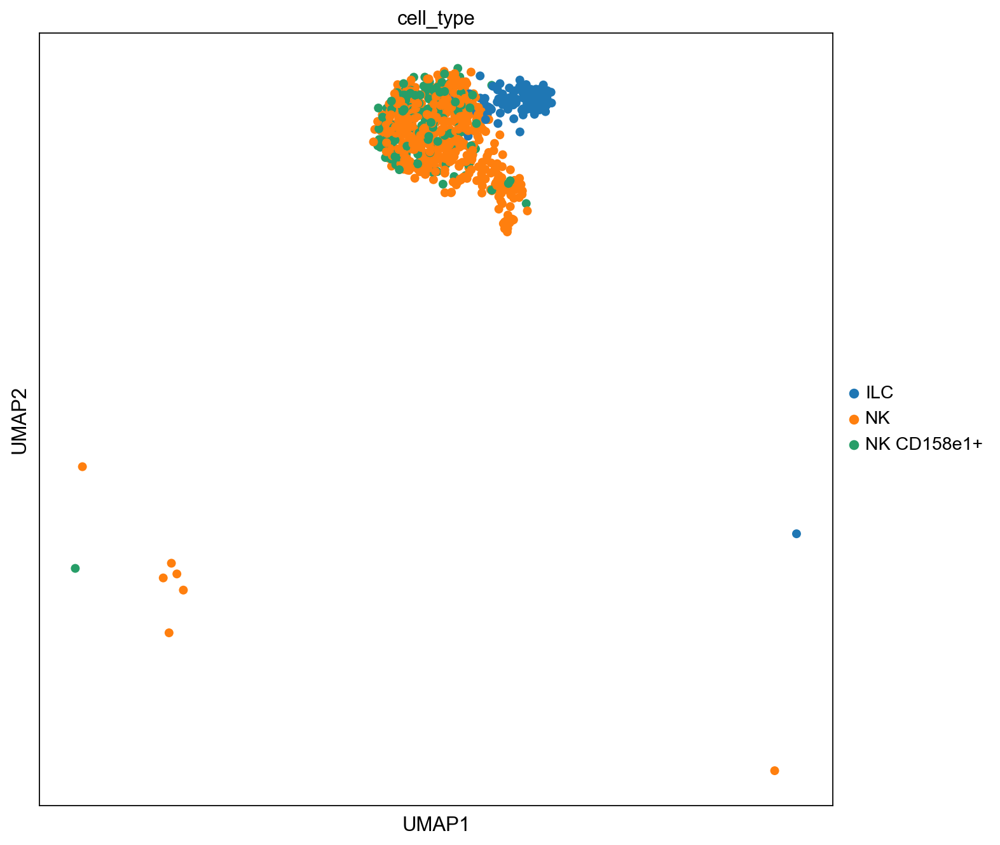

In [34]:
sc.pl.umap(sample_nk, color = ['cell_type'])

In [35]:
#Calculating new neigbors, one sample, all cell types

sc.pp.neighbors(eg, use_rep="X_totalVI")   #indicated representation

sc.tl.umap(eg)

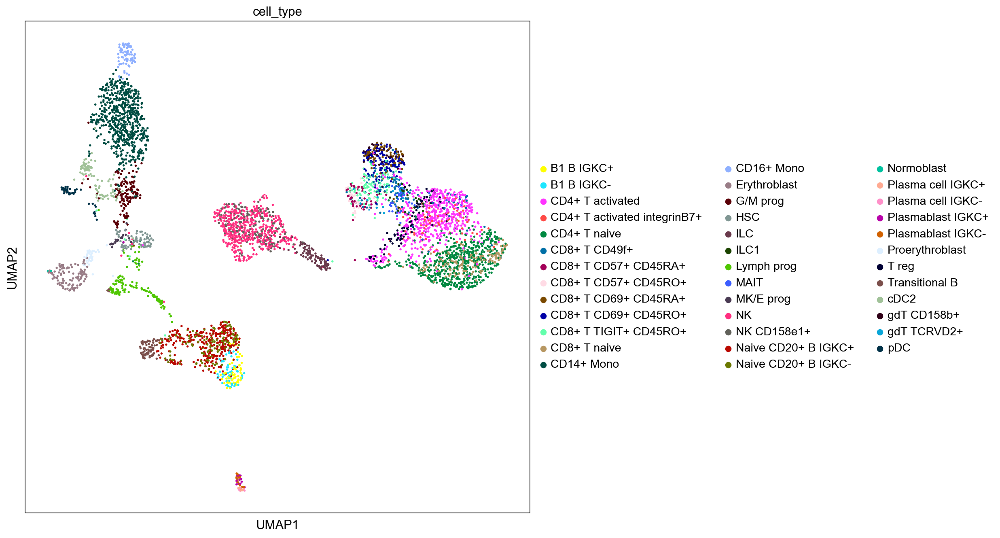

In [36]:
#only one sample

sc.set_figure_params(figsize=(10, 10))

sc.pl.umap(eg, color = ['cell_type'])

In [37]:
#Calculating new neigbors, one sample, all cell types

sc.pp.neighbors(sample_nk, use_rep="X_totalVI")   #indicated representation

sc.tl.umap(sample_nk)

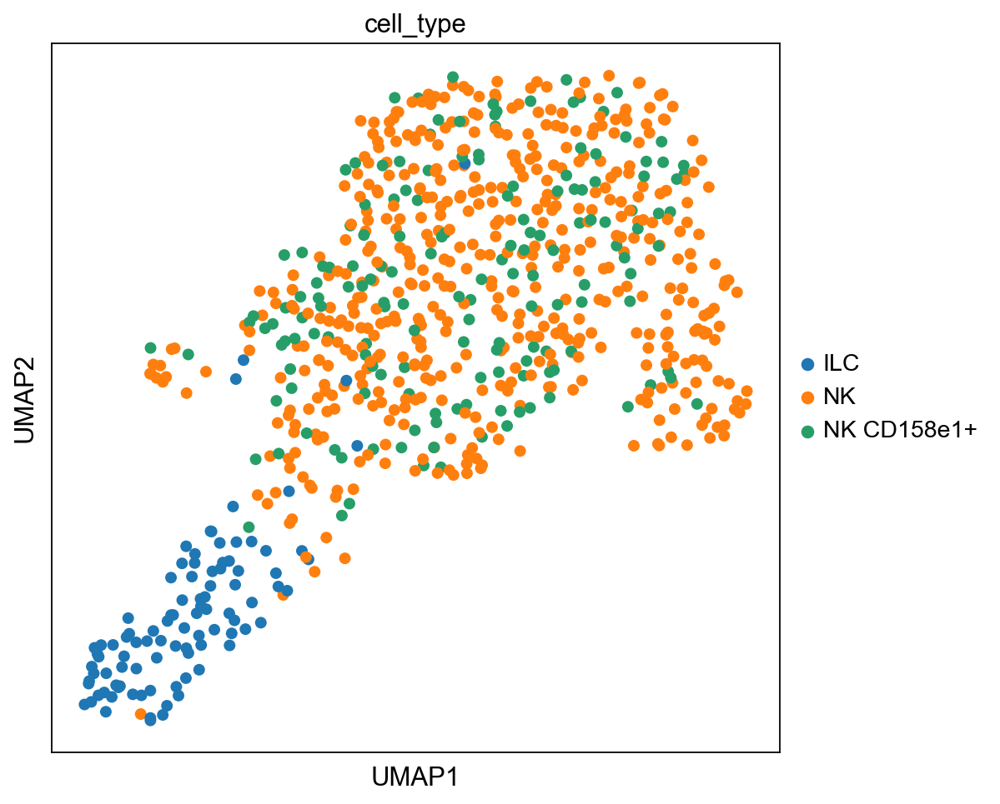

In [39]:
#one sample, only NKs + ILCs

sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(sample_nk, color = ['cell_type'])

## Reference 4 Yang et al. 

- sscRNA-seq on BM and PB

- Cells from six BM donors were combined into one group and the two peripheral blood donors into another for analyses. In total, 5567 and 3046 NK cells from the BM and blood. 

- Recently, the definition of the NK cell-restricted progenitor population has been redefined as Lin− CD34+CD38+CD123−CD45RA+CD7+CD10+CD127− cells as a consistent fraction of putative NK precursors in secondary lymphoid organs turn out to be ILCs or ILC progenitors

- NK cell maturation occurs mostly in secondary lymphoidal organs. The analyses of NK cells from secondary lymphoidal organs will give insights into early NK developmental stages. In this study they were not able to detect earlier development states of NK cells

- Markers to define NK lineage: CD94 (KLRD1), NKp80 (KLRF1), NKG7, GNLY. NCAM1 (CD56) was not well represented in this study

- Markers used to catch NK cell progenitors/ILCs: Lin−, CD7+ (not all cells yet CD56+). 

- Progenitors (Lin-, CD7+), within this population 90% are CD56bright NK (CD56+).

- Remaining CD56dim/- cells: over 50% express KLRC1 (NKp80) and CD16 => mature NK cells, rest (CD7+, CD56dim/−, CD16−, NKp80−) probably ILCs, NK progenitors, immature NK cells or immature cells with multiple lineages potential.  

- maturation of  CD56dimCXCR4+ NK cells = NKG2A, CD62L, CD57


### 7 clusters from BM NK cells: #

- CD56bright NK

- Transitional NK (intermediate expression of signature genes of either CD56bright or CD56dimCD57+ NK cells)

- Active NK : same features as inflamed NK. Several genes that belong to the immediate early genes (IEGs). IEGs are induced rapidly in response to stimuli without nascent protein synthesis. Active transcription, activation of several signaling pathways (KRAS-MAPK, TRAF6-NF-kappa-B. Active NK cluster is potentially within the CD56dim NK population (mature NKs) with a decreased expression of the genes encoding cytolytic proteins compared to the mature NK cluster. Maybe not unique developmental stage. 

- Adaptive NK: High KLRC2 expression, only detected from BM, mostly composed of cells of one donor. Also cells from few other samples detected, not high KLRC2, but instead high CD52 expression.

- Mature NK:  High expression of molecules important for cytotoxic function. Enrichment of gene sets, including the apical junction, regulation of actin cytoskeleton, NK cell-mediated cytotoxicity, and structure constituent of the cytoskeleton in the “Mature NK” cluster com- pared to the rest of the cells

- Terminal NK: Mature NK and terminal NK clusters together form the CD57+ cell population. Similar transcriptional and functional profile as mature NKs, but increased expression of ZEB2,  CX3CR1 and HAVCR2 (TIM-3). Dampened signaling and metabolic profiles => quiescent state? 

- Inflamed NK (mostly composed of cells of one patient, who donored BM) 


### Markers: #

- CD56brigh: IL7RA (IL7R), CD62L (SELL), NKG2A (KLRC1), granzyme K (GZMK), CD44, XCL1, XCL2, 

- Inflamed NK: IFIT3, IFIT2, TNF, CD69

- Active NK: NFKBIA, JUN, JUNB, ZFP36, DOS, FOSB, DUSP1, NR4A2, CXCR4

- Adaptive: KLRC2 (NKG2C), CD52, CD3E/D/G. Low expresison of FcεRγ (FCER1G), SYK (SYK), EAT-2 (SH2D1B), and PLZF (ZBTB16) compared to other clusters

- Mature NK: CD57, PRF1, GZMA, GZMB, GZMH, ACTB, ARPC2, CORO1A, CFL1, CST7, PFN1, ANXA1). Additionally: WDR74, SNORD3A, TMEM107, SNORD3D, RNU12, SNORD3B-2, SNORD3B-1, C12orf57, HIST1H1E, HIST1H1C, HIST1H1D, RNU11, PTCD2, RP11-386I14.4

- Terminal NK: Similar transcriptional and functional profile as mature NKs, but increased expression of ZEB2,  CX3CR1 and HAVCR2 (TIM-3). 



In [209]:
is_nk_yang = ['KLRD1', 'KLRF1', 'NKG7', 'GNLY', 'NCAM1'] #the most DE genes in NK cells
is_nk_yang_prot = ['CD94','CD56'] 


#NKp80 not in the ab panel of Neurips

# KLRD1 = CD94, NCAM1 = CD56

In [210]:
#Used to check which genes were measured

listOfmarkers= is_nk_yang
is_nk_yang = []

for x in listOfmarkers:
    if x in adata_neurips.var_names:
        is_nk_yang.append(x)

print(is_nk_yang)


['KLRD1', 'KLRF1', 'NKG7', 'GNLY', 'NCAM1']


In [211]:
#Used to check which markers were measured


listOfmarkers= ["CD159"]

for x in listOfmarkers:
    if x in prot.columns:
        print(x)



In [212]:
sample_nk.obs["CD94"]

GTAGTACCAATCCTTT-1-s4d1    2.475005
CTGTGGGTCATGCGGC-1-s4d1    1.408073
GCAACATTCGCAAGAG-1-s4d1    2.174035
TCACGGGTCGCACGAC-1-s4d1    3.016060
CGCCAGAAGACCATTC-1-s4d1    2.826218
                             ...   
CGTGATACACGACCTG-1-s4d1    2.580613
AGTCAACTCGCACGAC-1-s4d1    2.763305
GTTCTATCACGTCGGT-1-s4d1    1.603495
TAGATCGTCTCTATAC-1-s4d1    2.104804
AAGACTCAGGGCAAGG-1-s4d1    3.085629
Name: CD94, Length: 760, dtype: float64

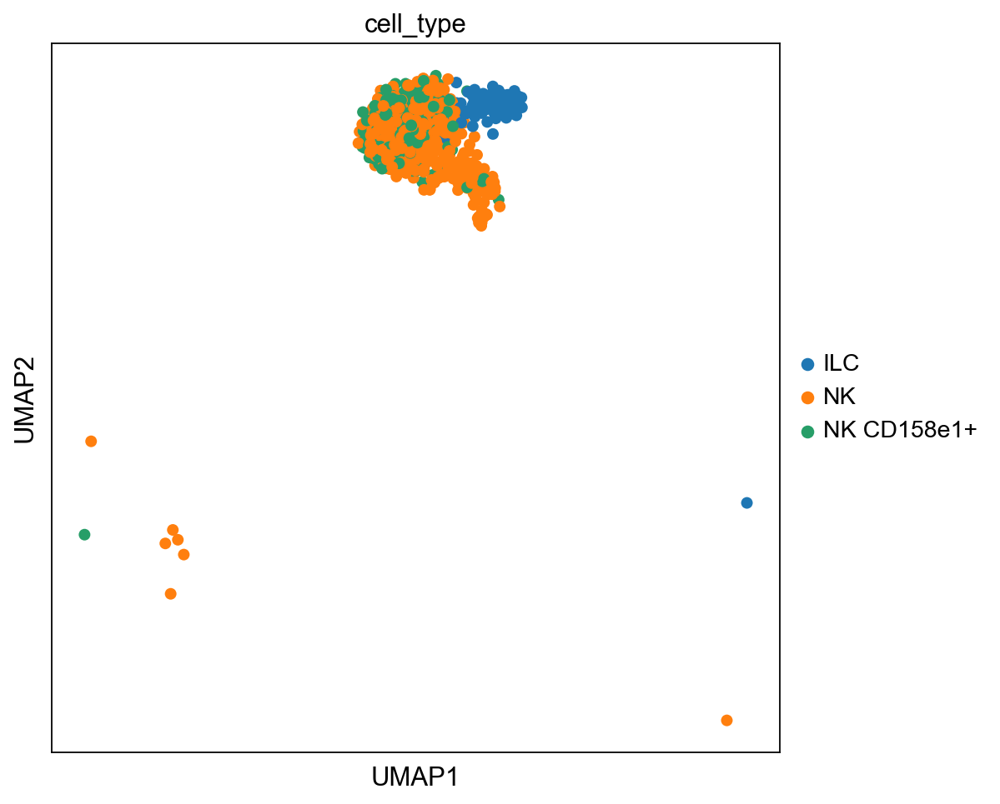

Is NK cell, RNA


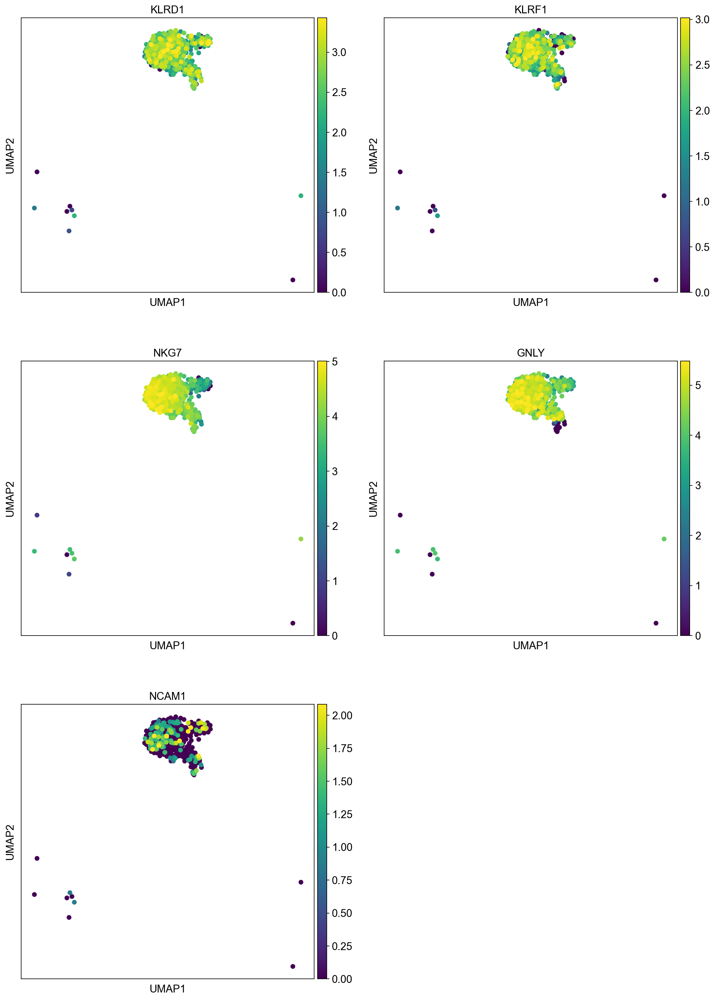

Is NK cell, protein (KLRD1 = CD94, NCAM1 = CD56)


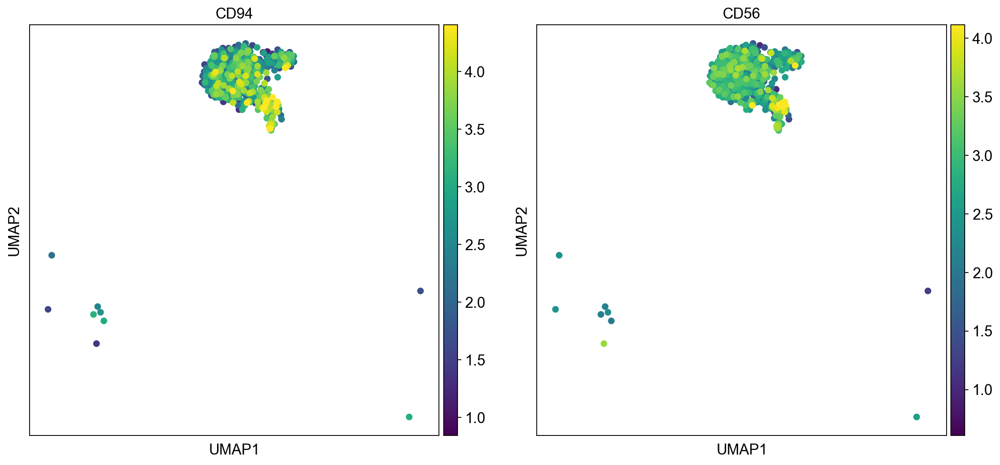

In [213]:
#Nk cell lineage definition
#KLRF1 = NKp80

sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Is NK cell, RNA")
sc.pl.umap(sample_nk, color = is_nk_yang, vmax="p99", color_map = 'viridis', ncols=2)

print("Is NK cell, protein (KLRD1 = CD94, NCAM1 = CD56)")

sc.pl.umap(sample_nk, color = is_nk_yang_prot, vmax="p99", color_map = 'viridis')

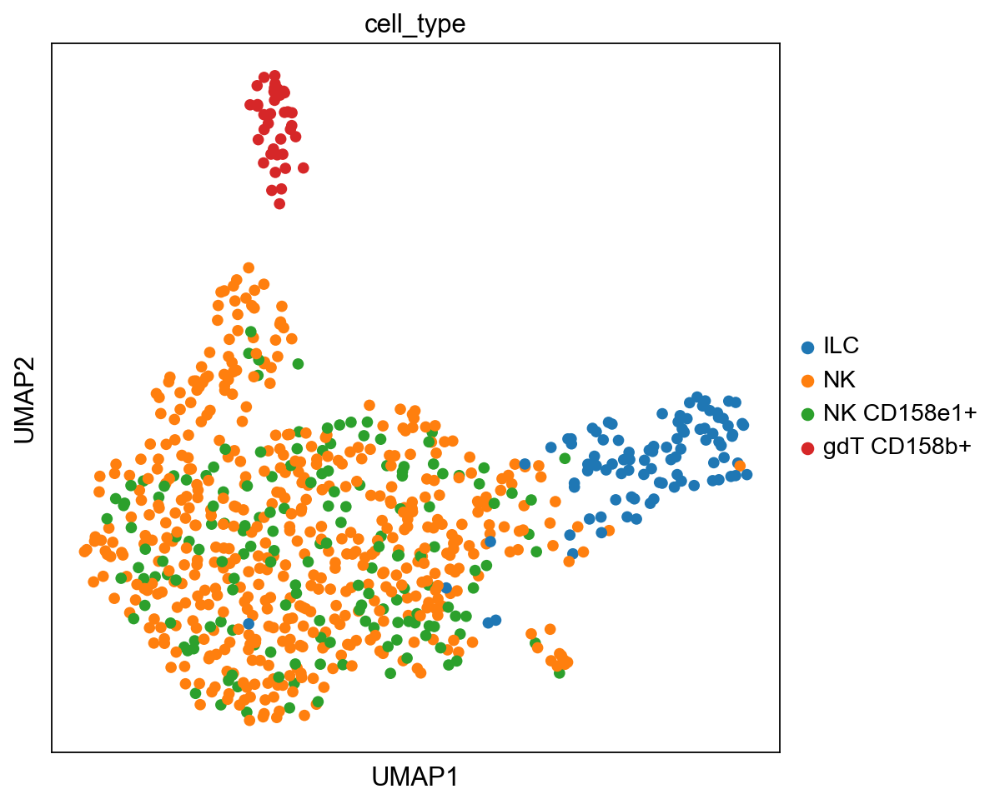

Inflamed NK cells, RNA


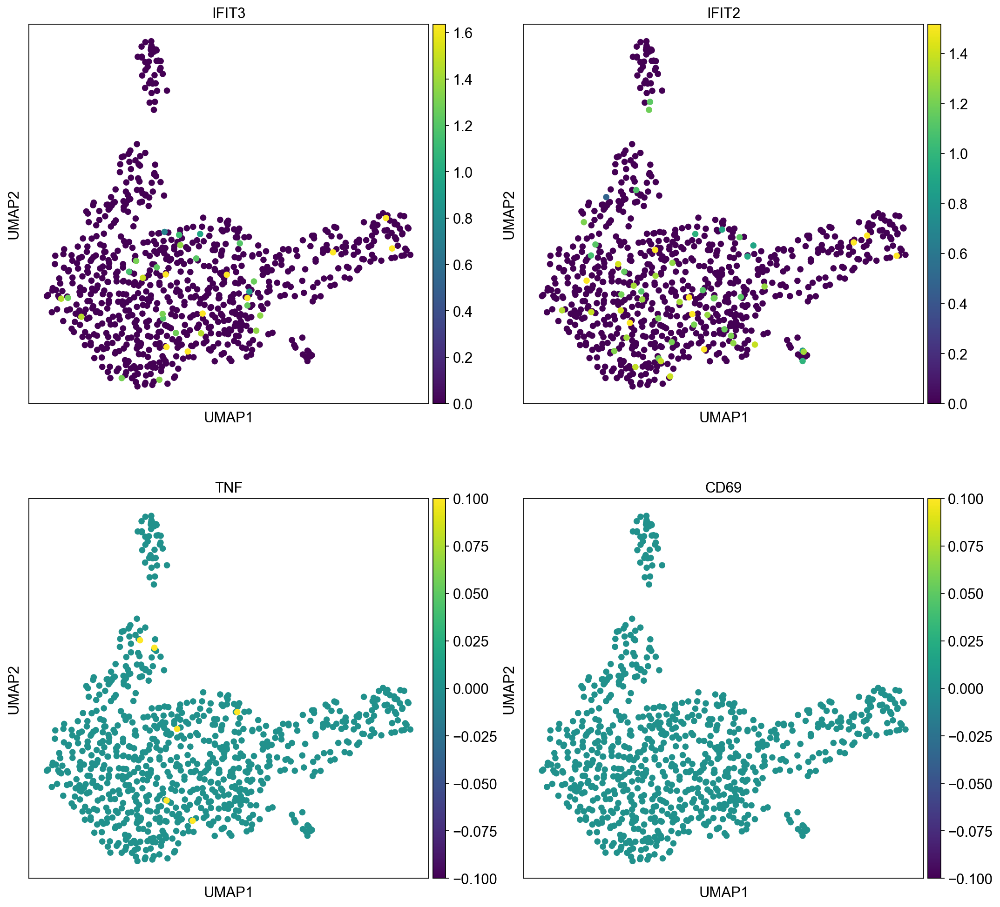

Inflamed NK cells, protein


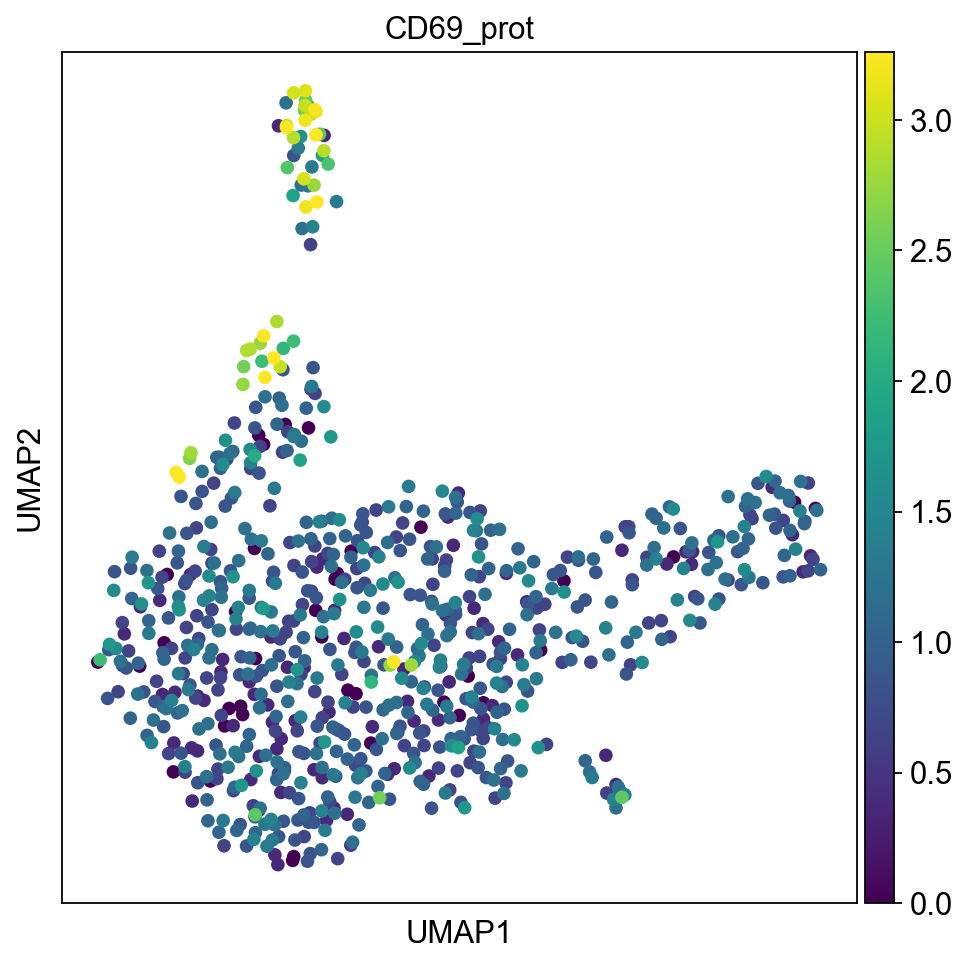

In [156]:
#Inflamed NK cells

sc.set_figure_params(figsize=(7, 7))

inflamed_nk = ['IFIT3', 'IFIT2', 'TNF', 'CD69']
inflamed_nk_prot = ['CD69_prot']

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Inflamed NK cells, RNA")
sc.pl.umap(sample_nk, color = inflamed_nk, vmax="p99", color_map = 'viridis', ncols=2)

print("Inflamed NK cells, protein")
sc.pl.umap(sample_nk, color = inflamed_nk_prot, vmax="p99", color_map = 'viridis', ncols=2)




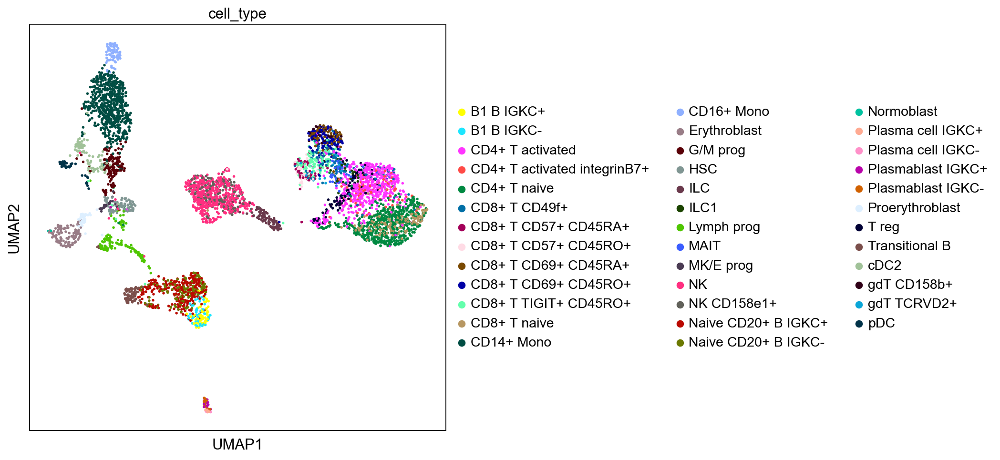

Inflamed NK cells, RNA


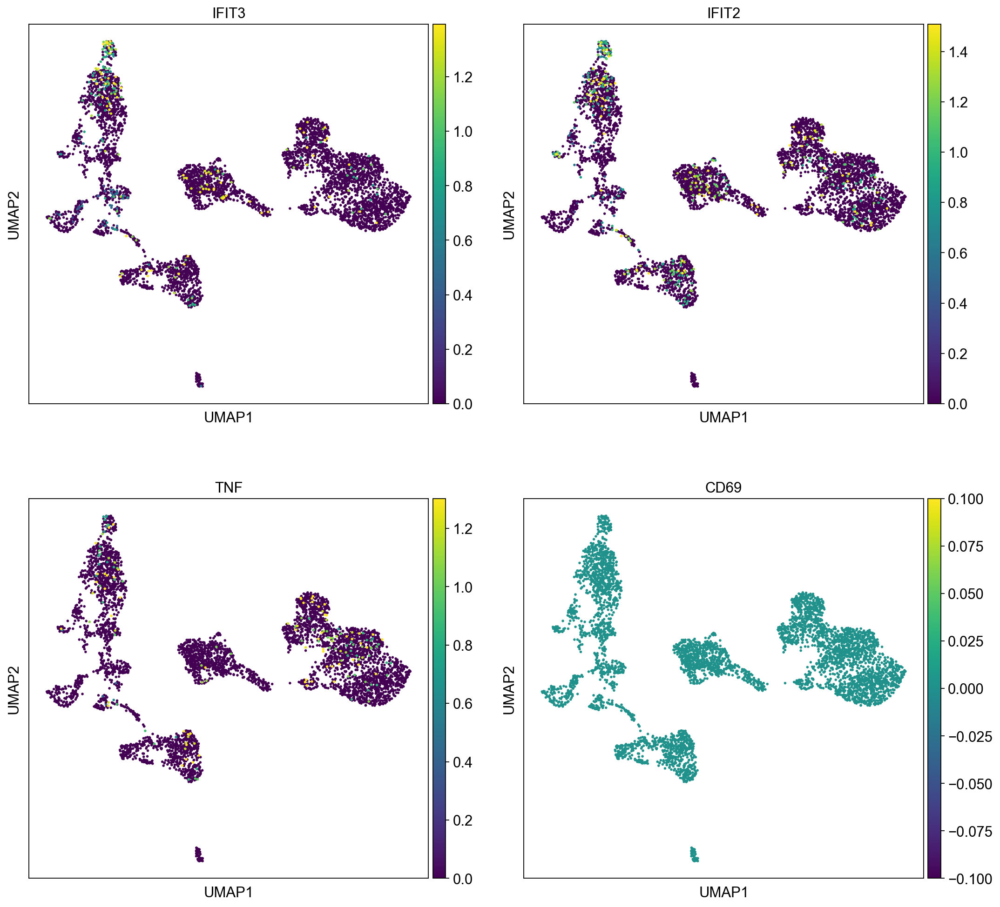

Inflamed NK cells, protein


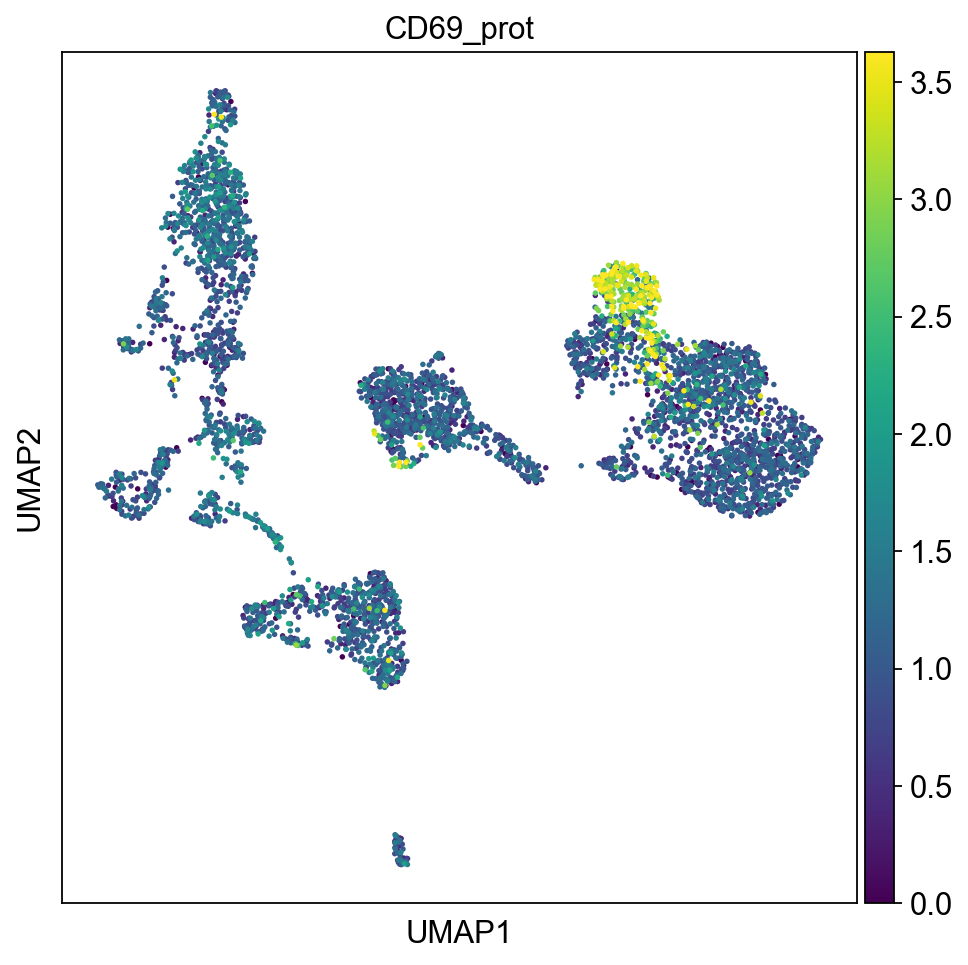

In [157]:
#All cell types

#Inflamed NK cells

sc.set_figure_params(figsize=(7, 7))

inflamed_nk = ['IFIT3', 'IFIT2', 'TNF', 'CD69']
inflamed_nk_prot = ['CD69_prot']

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Inflamed NK cells, RNA")
sc.pl.umap(eg, color = inflamed_nk, vmax="p99", color_map = 'viridis', ncols=2)

print("Inflamed NK cells, protein")
sc.pl.umap(eg, color = inflamed_nk_prot, vmax="p99", color_map = 'viridis', ncols=2)




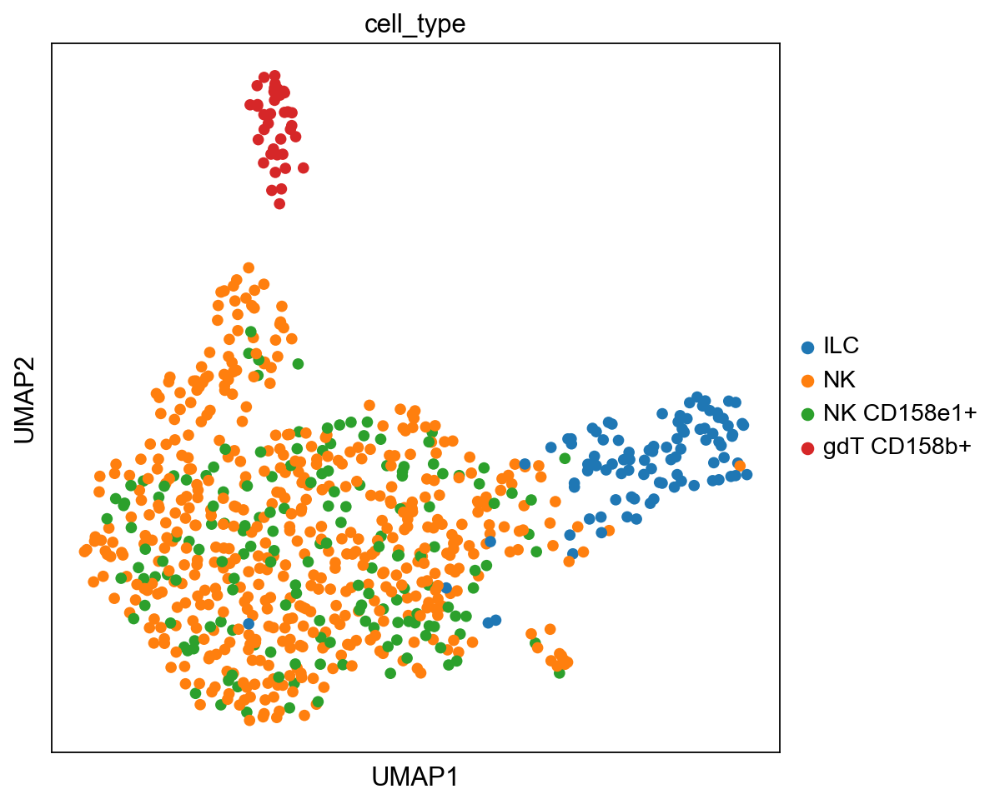

Active NK cells, RNA


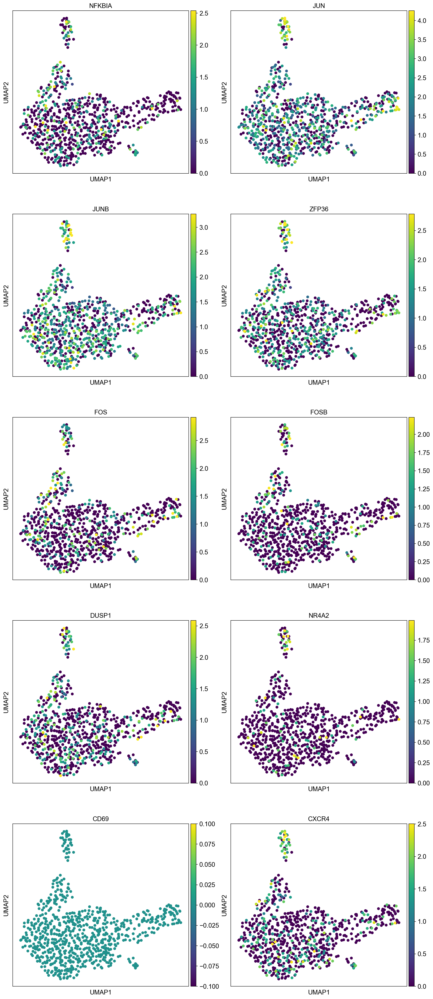

Active NK cells, protein


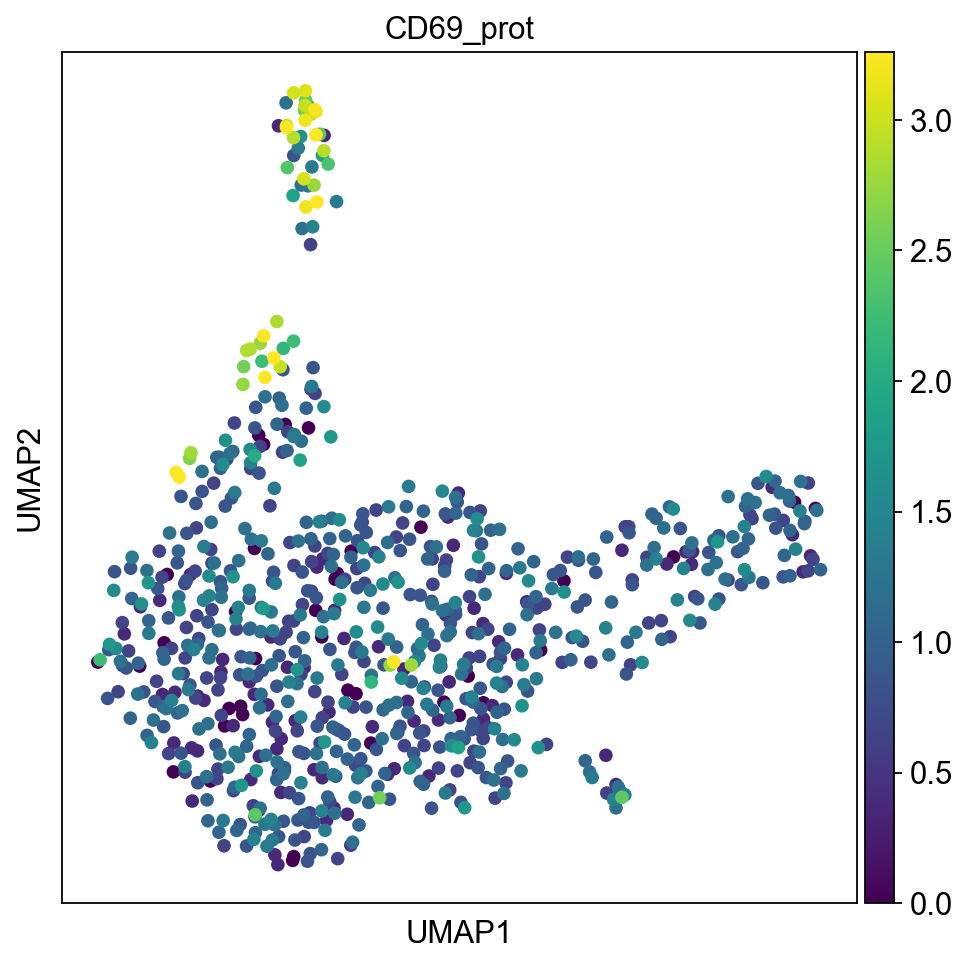

In [158]:
#Active NK cells
#Expression of is CXCR4 reduced when NK cells become functionally mature

active_nk= ['NFKBIA', 'JUN', 'JUNB', 'ZFP36', 'FOS', 'FOSB', 'DUSP1', 'NR4A2', 'CD69','CXCR4']
active_nk_prot = ["CD69_prot"]

sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Active NK cells, RNA")
sc.pl.umap(sample_nk, color = active_nk, vmax="p99", color_map = 'viridis', ncols=2)

print("Active NK cells, protein")
sc.pl.umap(sample_nk, color = active_nk_prot, vmax="p99", color_map = 'viridis', ncols=2)




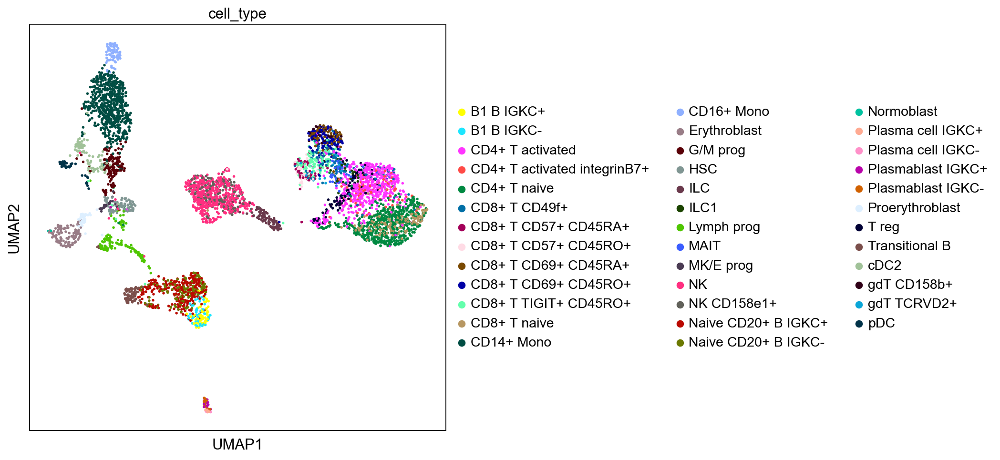

Inflamed NK cells, RNA


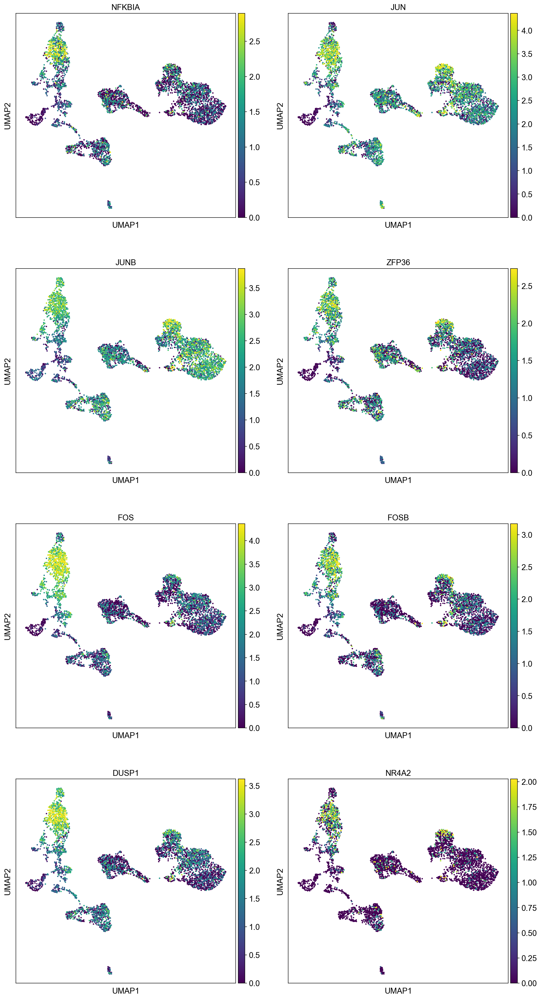

In [159]:
#All cell types
#Active NK cells

active_nk= ['NFKBIA', 'JUN', 'JUNB', 'ZFP36', 'FOS', 'FOSB', 'DUSP1', 'NR4A2']

sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Inflamed NK cells, RNA")
sc.pl.umap(eg, color = active_nk, vmax="p99", color_map = 'viridis', ncols=2)




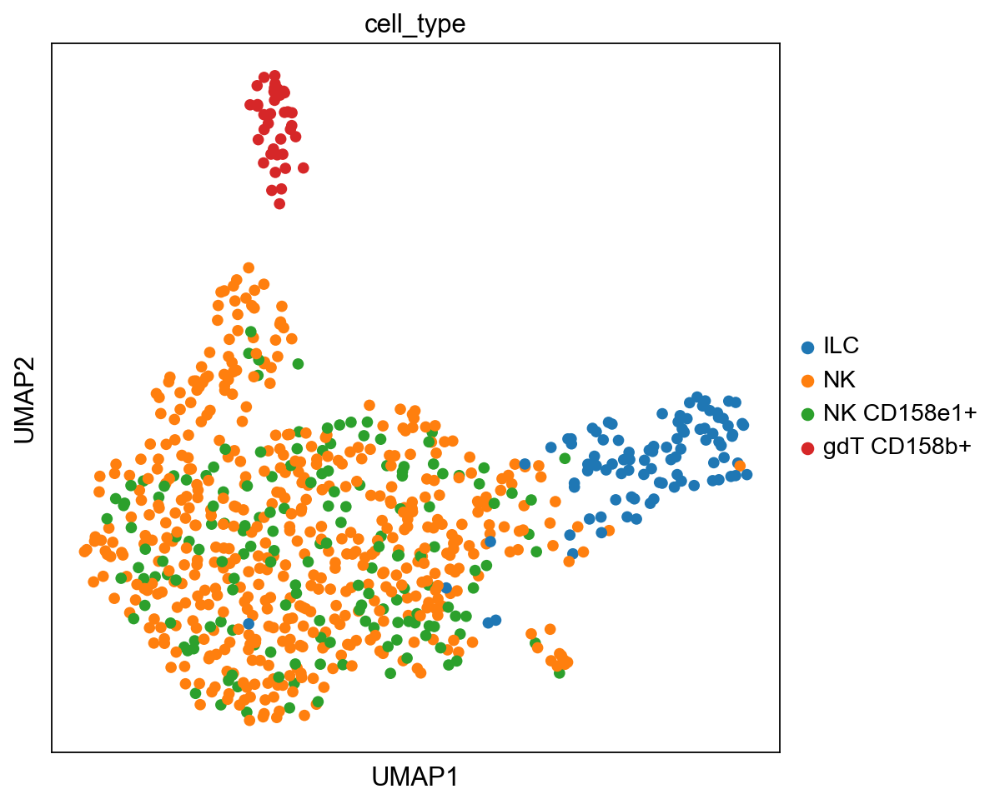

Maturation CD56dimCXCR4+ NK cells, RNA


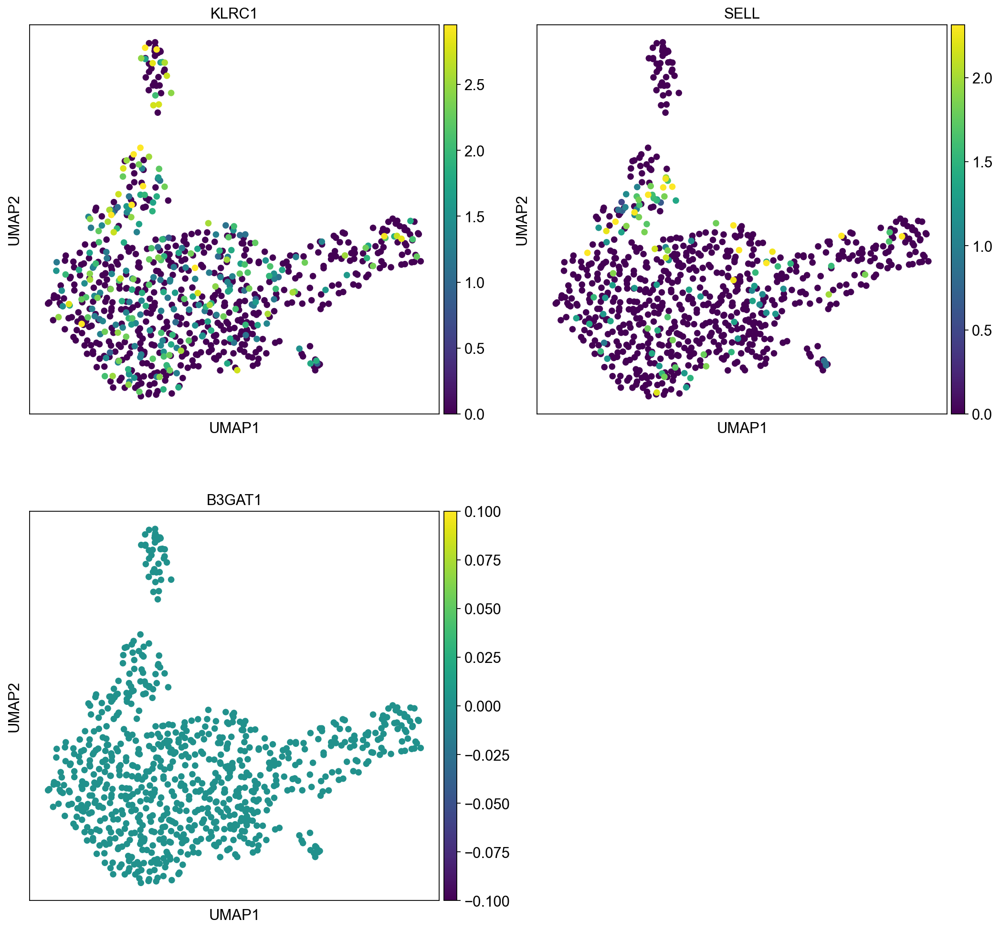

Maturation of CD56dimCXCR4+ NK cells, protein


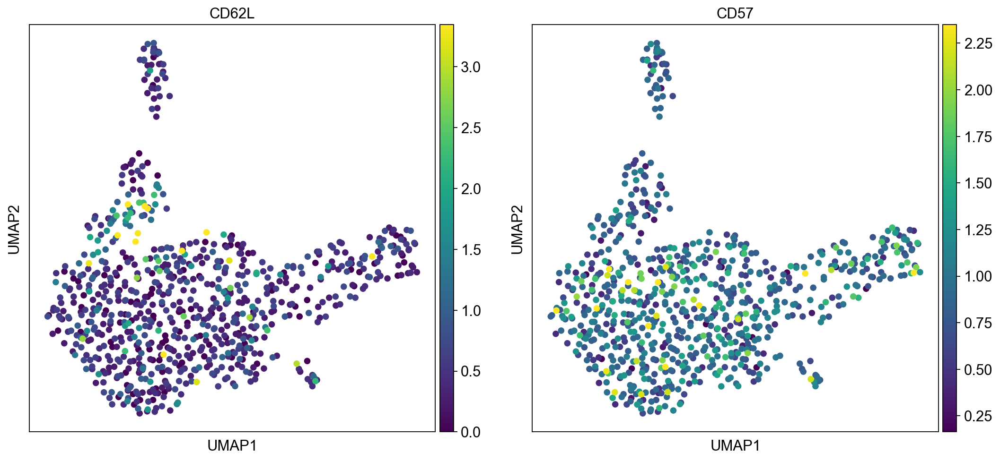

In [160]:
#maturation of CD56dimCXCR4+ NK cells identified using these markers. 
#The cell surface expression of NKG2A (KLRC1) and CD62L decrease as NK cells mature
#CD57 is generally considered the marker for terminally mature NK cells30

maturation_rna = ['KLRC1', 'SELL', 'B3GAT1']
maturation_prot = ['CD62L', 'CD57']   #NKG2A = KLRC1

#Maturation of CD56dimCXCR4+ NK cells

sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Maturation CD56dimCXCR4+ NK cells, RNA")
sc.pl.umap(sample_nk, color = maturation_rna, vmax="p99", color_map = 'viridis', ncols=2)

print("Maturation of CD56dimCXCR4+ NK cells, protein")
sc.pl.umap(sample_nk, color = maturation_prot, vmax="p99", color_map = 'viridis', ncols=2)




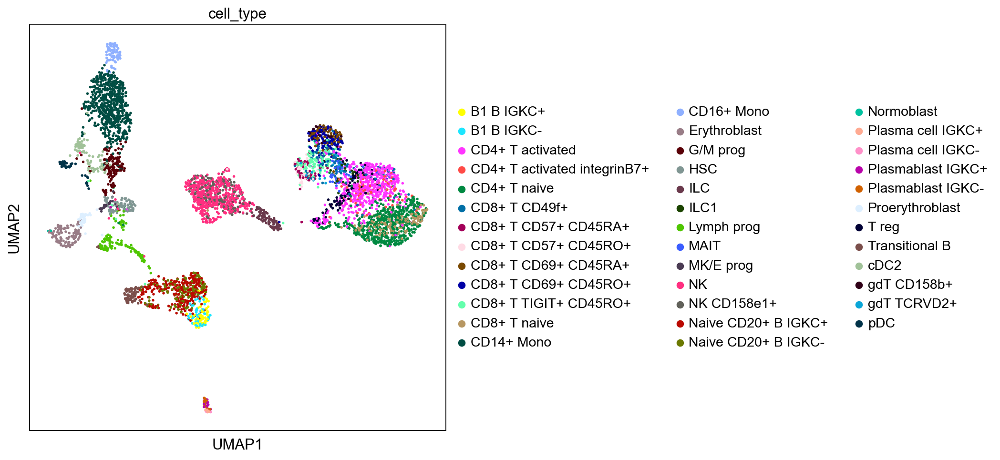

Maturation CD56dimCXCR4+ NK cells, RNA


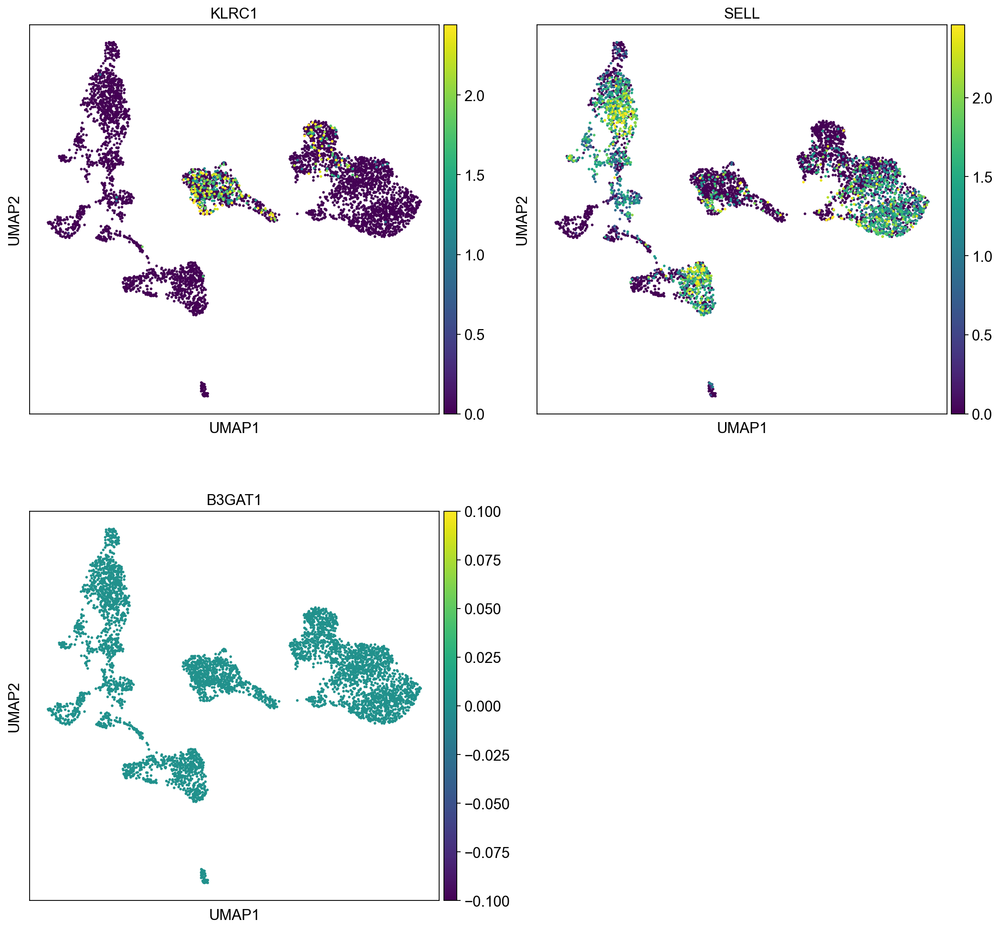

Maturation of CD56dimCXCR4+ NK cells, protein (SELL = CD62L, B3GAT1 = CD57)


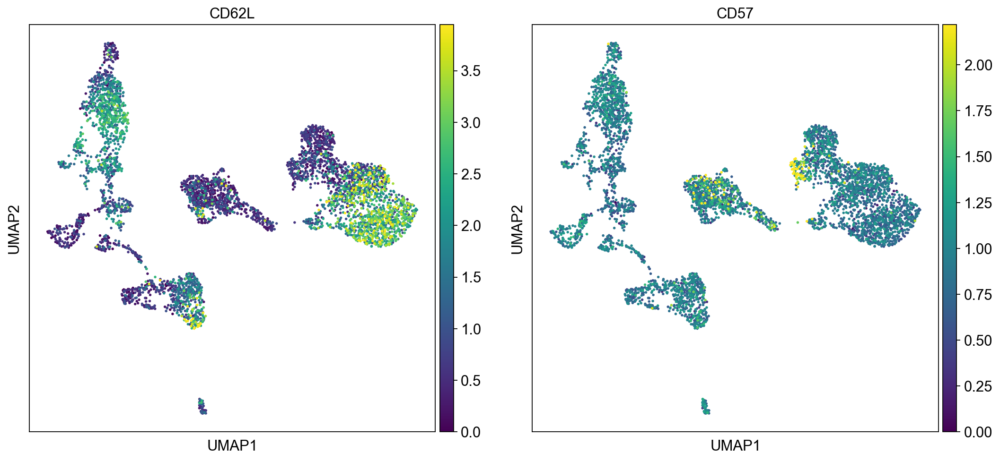

In [161]:
maturation_rna = ['KLRC1', 'SELL', 'B3GAT1']
maturation_prot = ['CD62L', 'CD57']   #NKG2A = KLRC1

#Maturation of CD56dimCXCR4+ NK cells

sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Maturation CD56dimCXCR4+ NK cells, RNA")
sc.pl.umap(eg, color = maturation_rna, vmax="p99", color_map = 'viridis', ncols=2)

print("Maturation of CD56dimCXCR4+ NK cells, protein (SELL = CD62L, B3GAT1 = CD57)")
sc.pl.umap(eg, color = maturation_prot, vmax="p99", color_map = 'viridis', ncols=2)



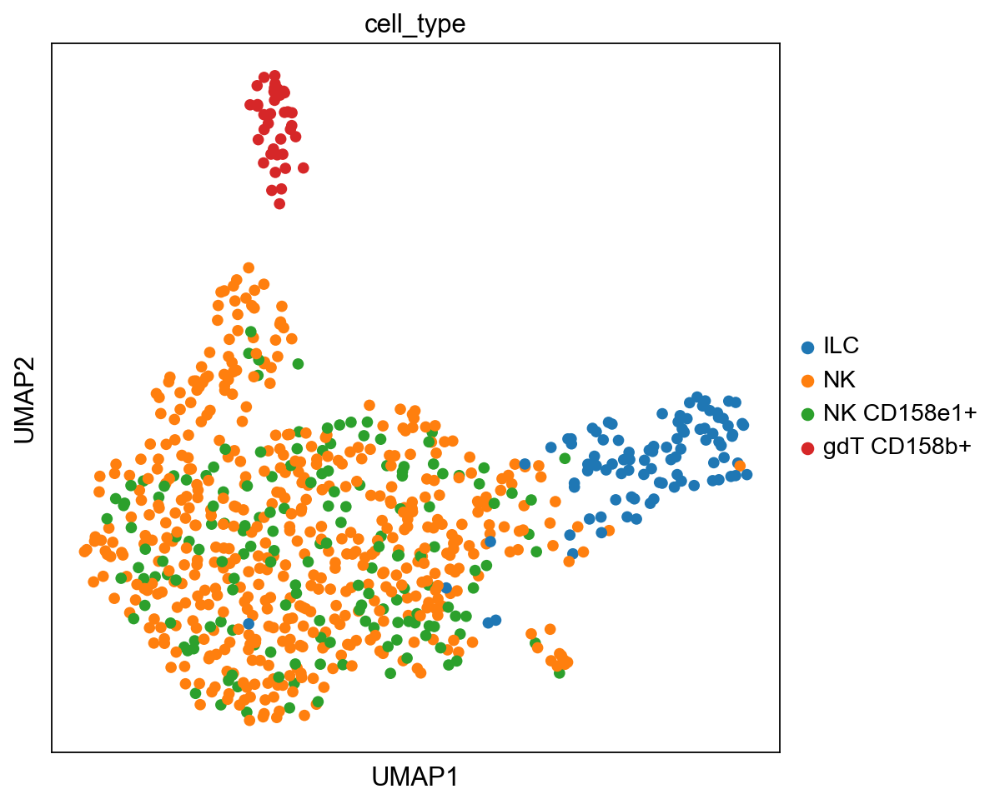

Adaptive NK cells, highly expressed, RNA


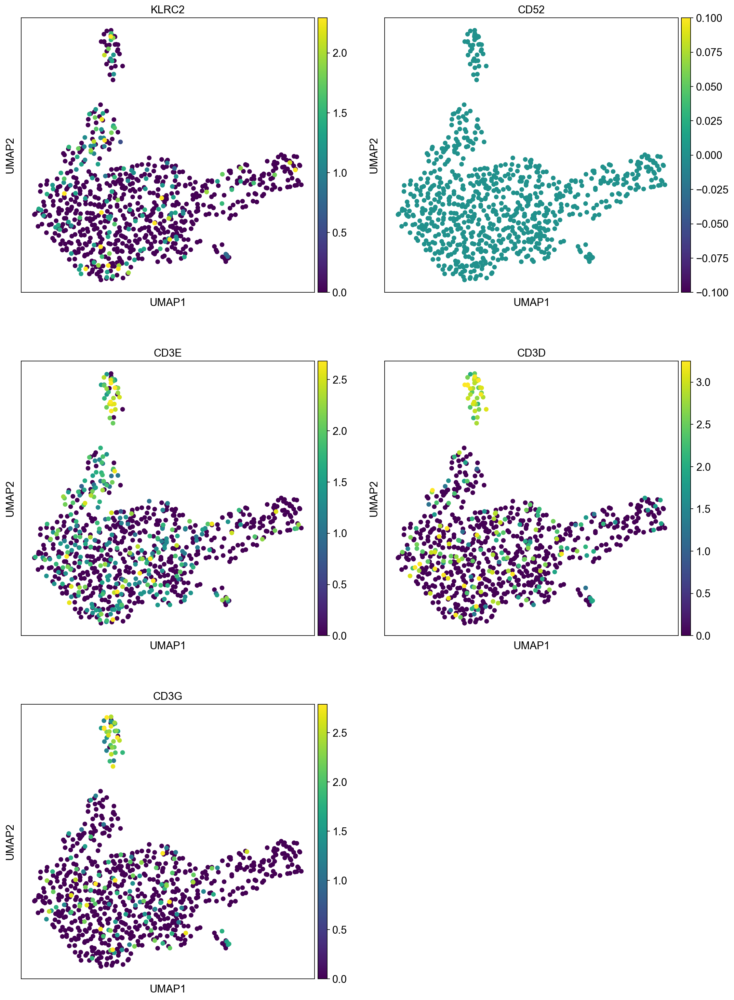

Adaptive NK cells, highly expressed, protein


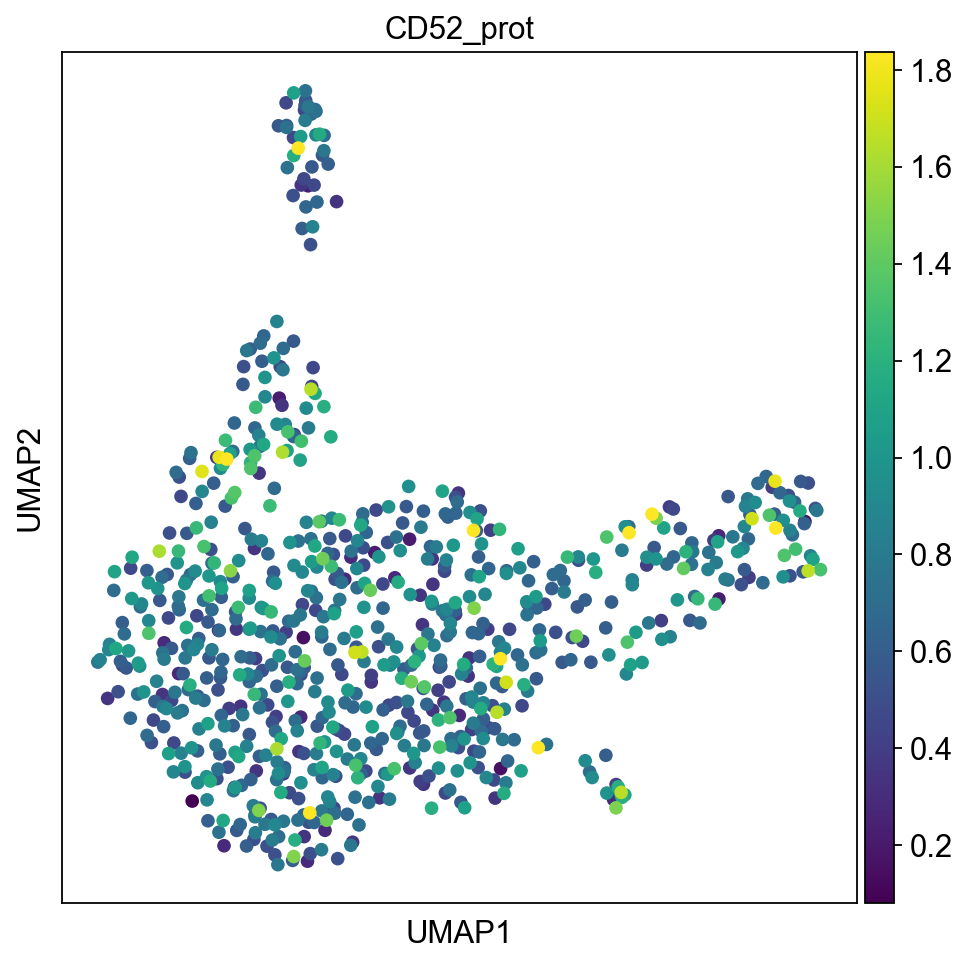

Adaptive NK cells, lower expression


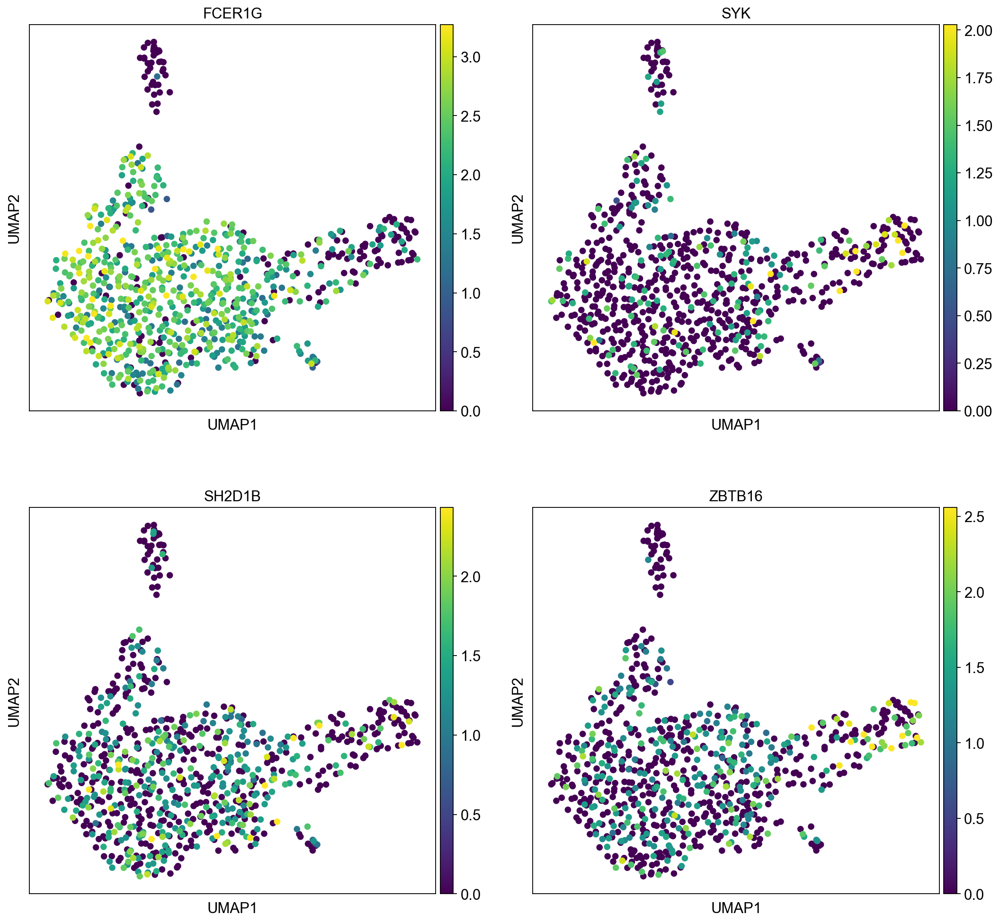

In [162]:
adaptive_high_rna = ['KLRC2', 'CD52', 'CD3E', 'CD3D', 'CD3G' ]
adaptive_low_rna = ['FCER1G', 'SYK', 'SH2D1B', 'ZBTB16']
adaptive_high_prot = ['CD52_prot']

#KLRC2 = CD195c, not used in the ab panel of Neurips

sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Adaptive NK cells, highly expressed, RNA")
sc.pl.umap(sample_nk, color = adaptive_high_rna, vmax="p99", color_map = 'viridis', ncols=2)

print("Adaptive NK cells, highly expressed, protein")
sc.pl.umap(sample_nk, color = adaptive_high_prot, vmax="p99", color_map = 'viridis', ncols=2)



print("Adaptive NK cells, lower expression")
sc.pl.umap(sample_nk, color = adaptive_low_rna, vmax="p99", color_map = 'viridis', ncols=2)




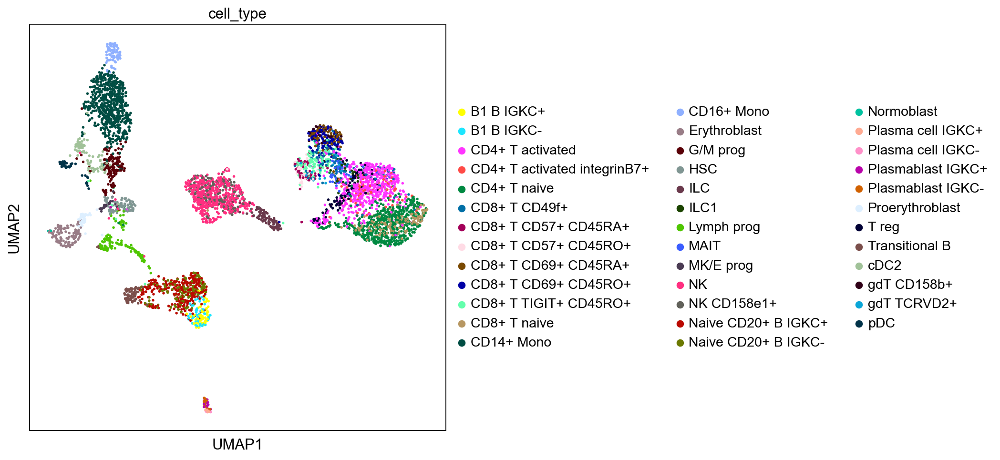

Adaptive NK cells, highly expressed, RNA


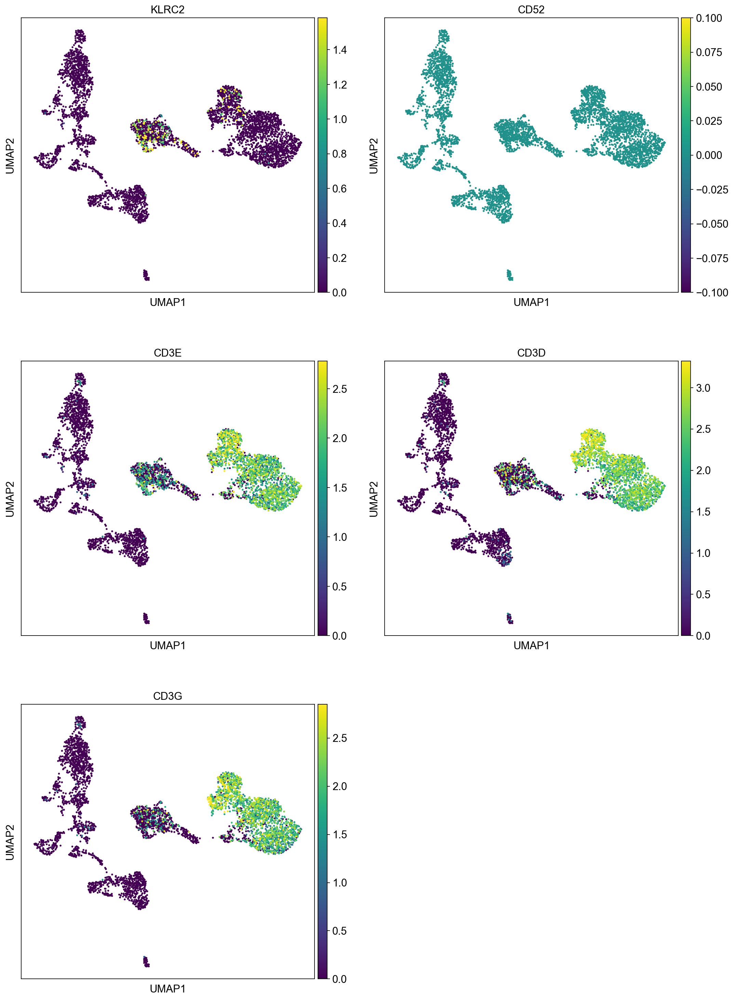

Adaptive NK cells, highly expressed, protein


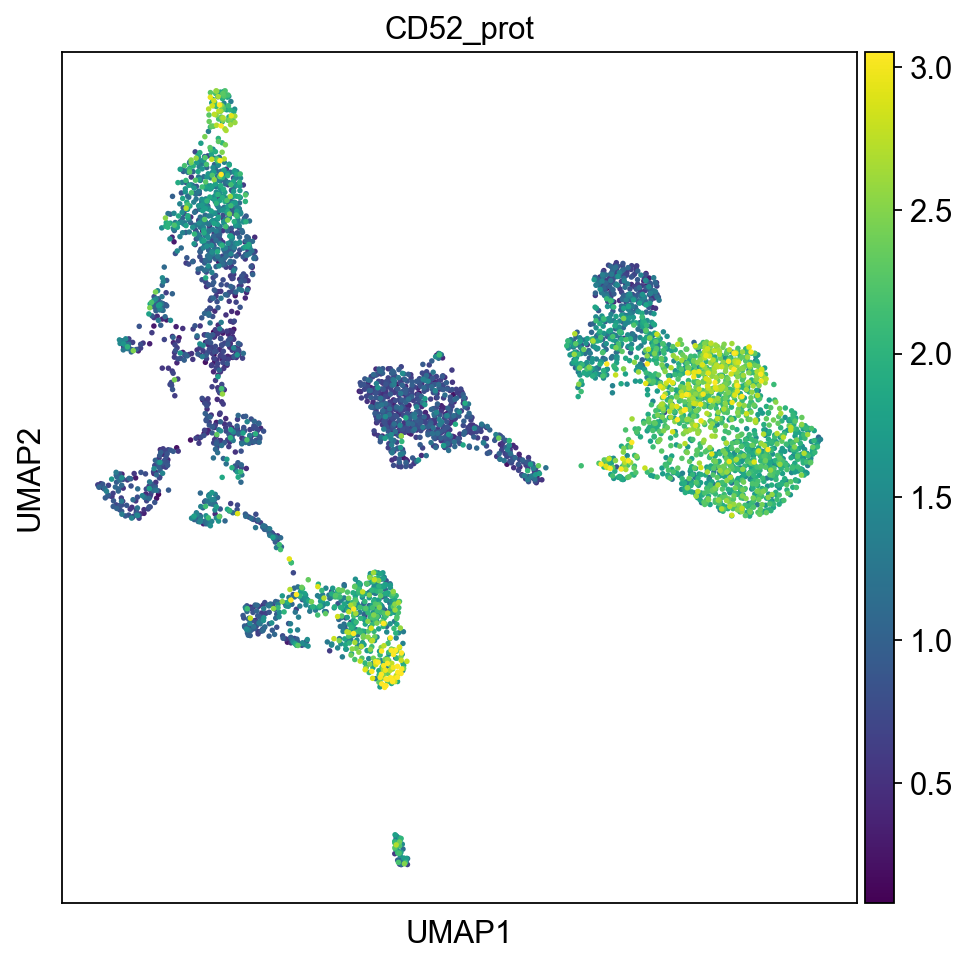

Adaptive NK cells, lower expression


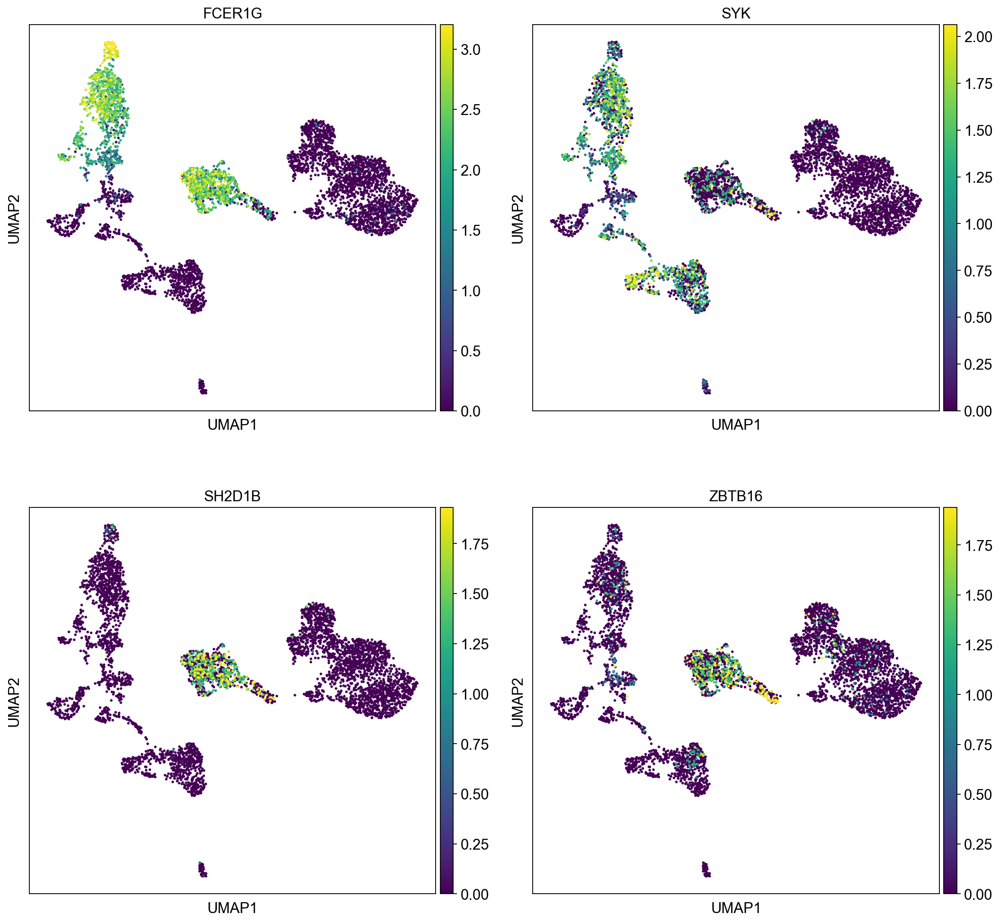

In [163]:
#All cell types

#KLRC2 = CD195c, not used in the ab panel of Neurips

sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Adaptive NK cells, highly expressed, RNA")
sc.pl.umap(eg, color = adaptive_high_rna, vmax="p99", color_map = 'viridis', ncols=2)

print("Adaptive NK cells, highly expressed, protein")
sc.pl.umap(eg, color = adaptive_high_prot, vmax="p99", color_map = 'viridis', ncols=2)



print("Adaptive NK cells, lower expression")
sc.pl.umap(eg, color = adaptive_low_rna, vmax="p99", color_map = 'viridis', ncols=2)




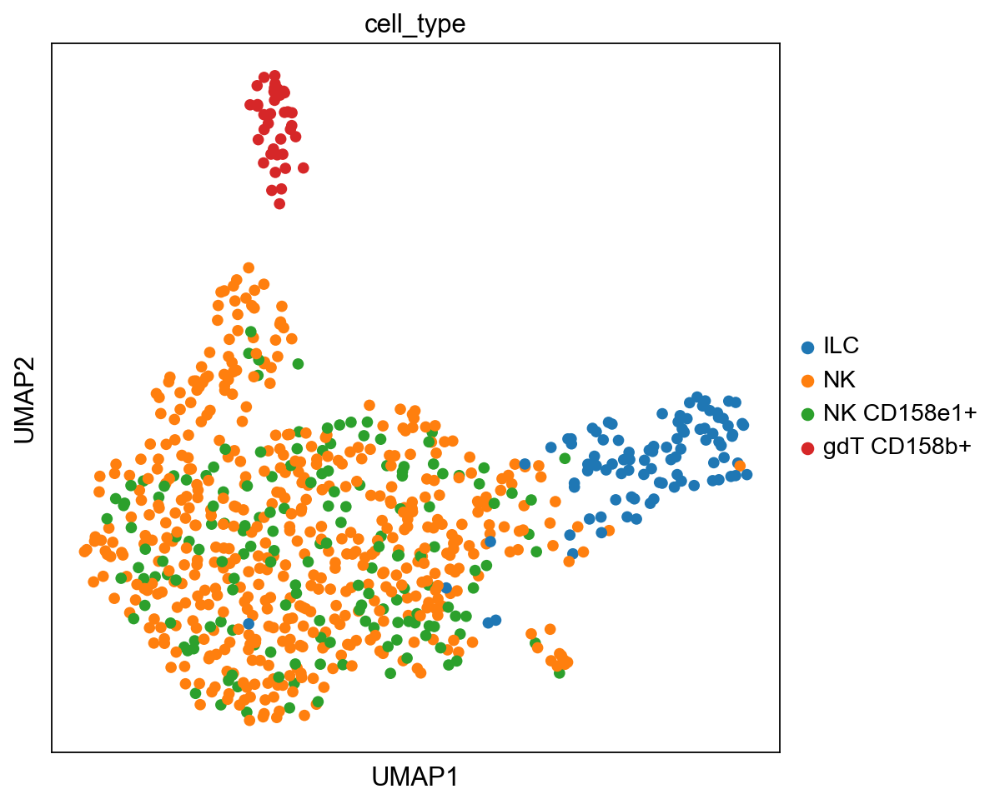

Mature NK cells, RNA


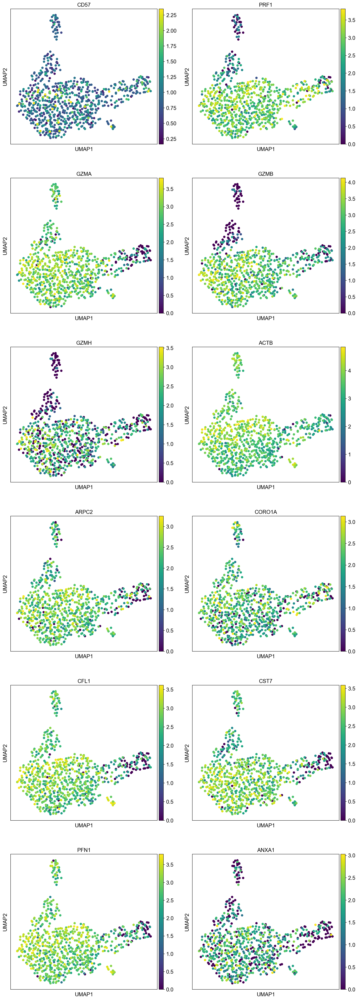

Mature NK cells, set 2,  RNA


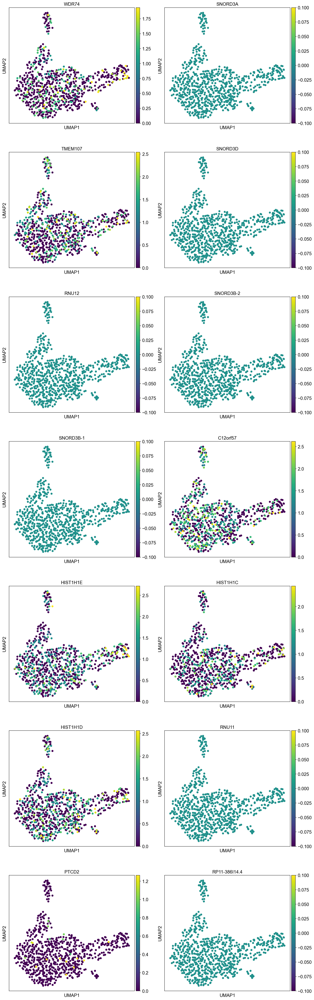

Mature NK cells, protein


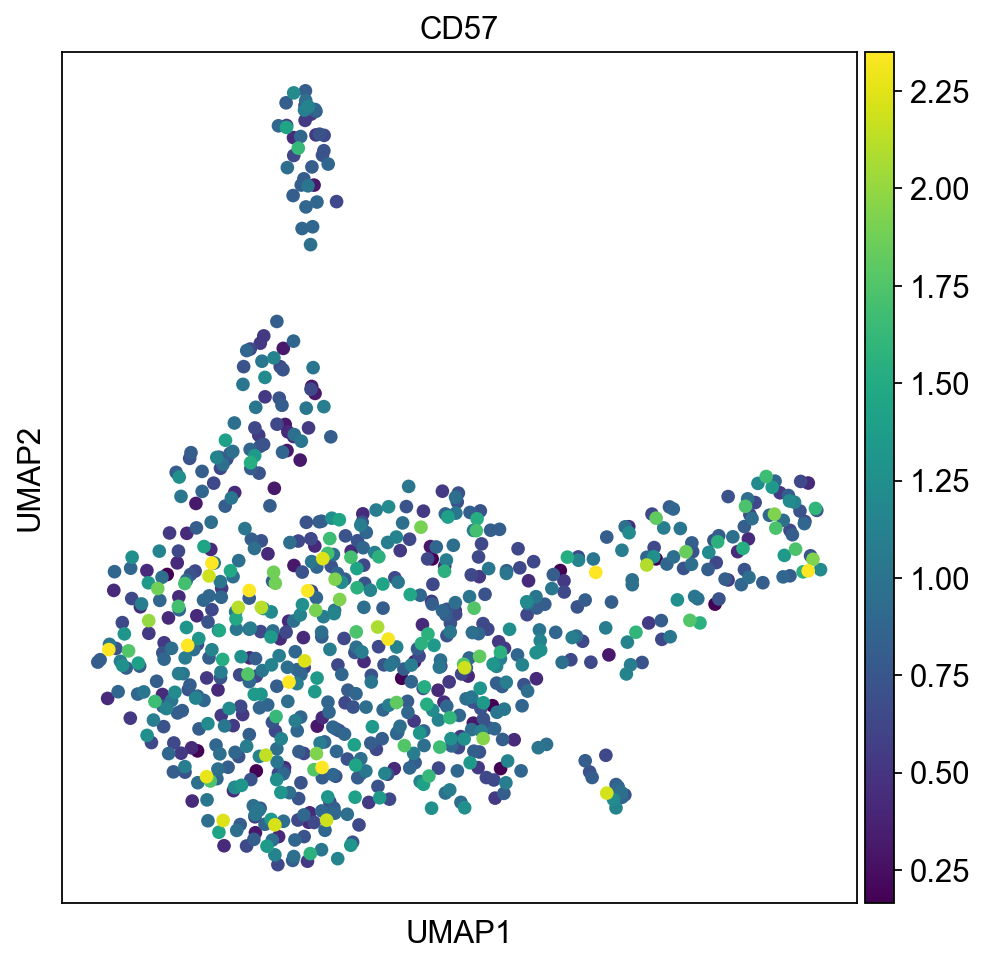

In [164]:
#Mature NKs

mature_rna= ['CD57', 'PRF1', 'GZMA', 'GZMB', 'GZMH', 'ACTB', 'ARPC2', 'CORO1A', 'CFL1', 'CST7', 'PFN1', 'ANXA1']
mature_rna2 = ['WDR74', 'SNORD3A', 'TMEM107', 'SNORD3D', 'RNU12', 'SNORD3B-2', 'SNORD3B-1', 'C12orf57', 'HIST1H1E', 'HIST1H1C', 'HIST1H1D', 'RNU11', 'PTCD2', 'RP11-386I14.4']

mature_prot = ['CD57']


sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Mature NK cells, RNA")
sc.pl.umap(sample_nk, color = mature_rna, vmax="p99", color_map = 'viridis', ncols=2)

print("Mature NK cells, set 2,  RNA")
sc.pl.umap(sample_nk, color = mature_rna2, vmax="p99", color_map = 'viridis', ncols=2)


print("Mature NK cells, protein")
sc.pl.umap(sample_nk, color = mature_prot, vmax="p99", color_map = 'viridis', ncols=2)



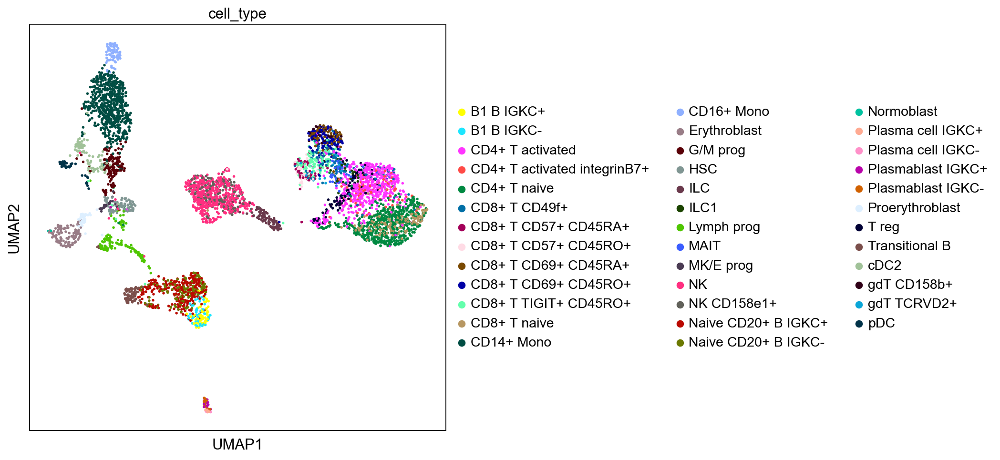

Mature NK cells, RNA


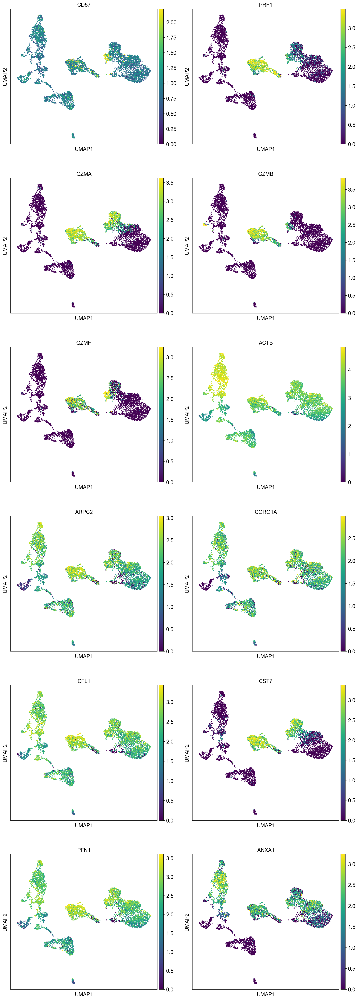

Mature NK cells, protein


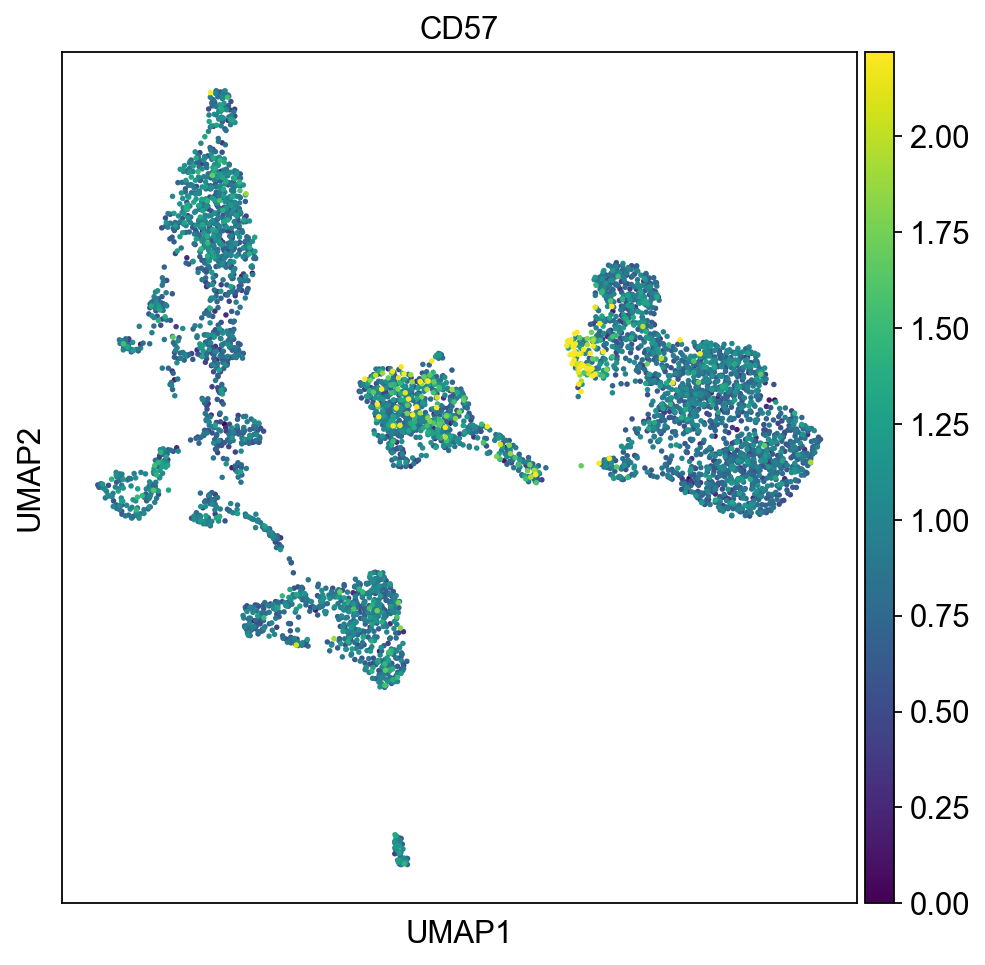

In [165]:
#Mature NKs

mature_rna= ['CD57', 'PRF1', 'GZMA', 'GZMB', 'GZMH', 'ACTB', 'ARPC2', 'CORO1A', 'CFL1', 'CST7', 'PFN1', 'ANXA1']
mature_prot = ['CD57']


sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Mature NK cells, RNA")
sc.pl.umap(eg, color = mature_rna, vmax="p99", color_map = 'viridis', ncols=2)

print("Mature NK cells, protein")
sc.pl.umap(eg, color = mature_prot, vmax="p99", color_map = 'viridis', ncols=2)




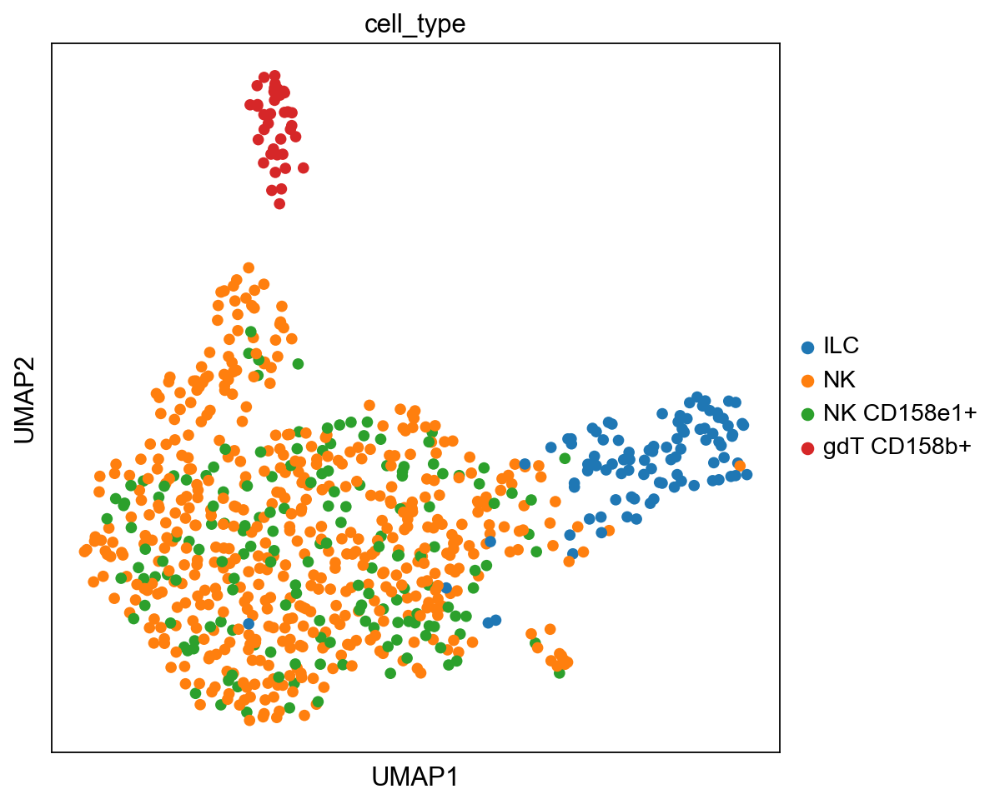

Terminally differentiated NK cells, RNA


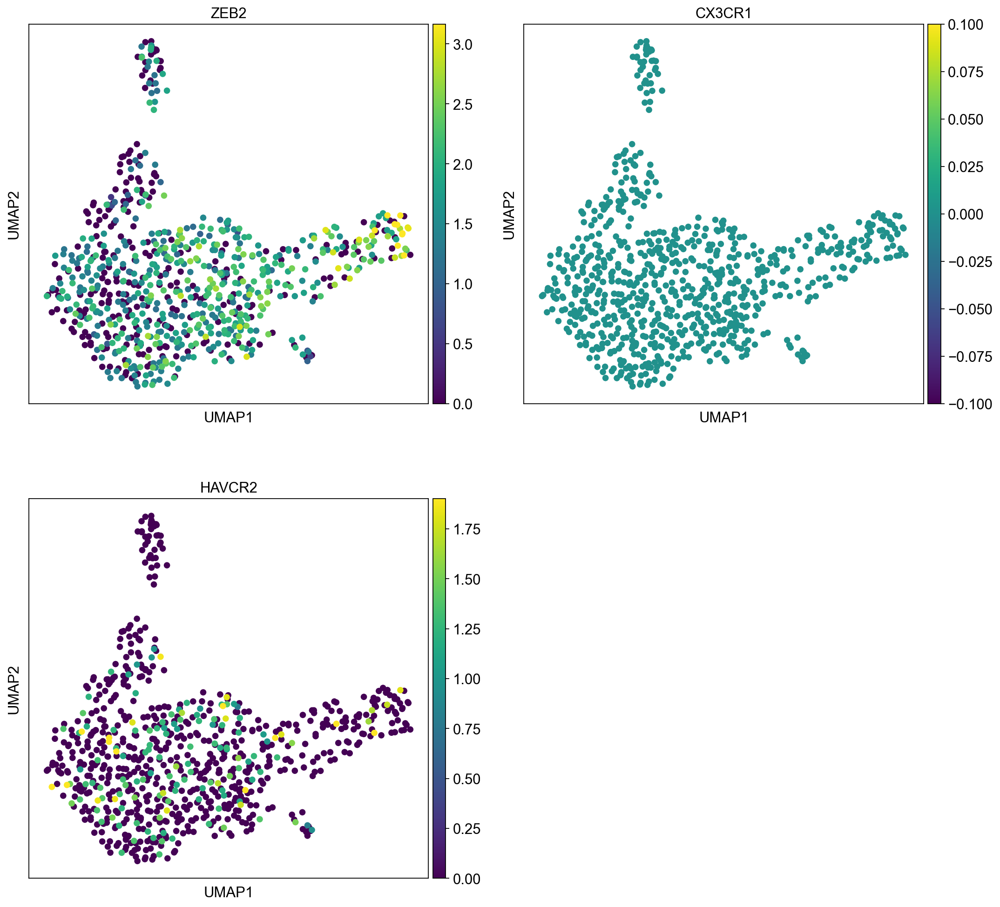

Terminally differentiated NK cells, protein


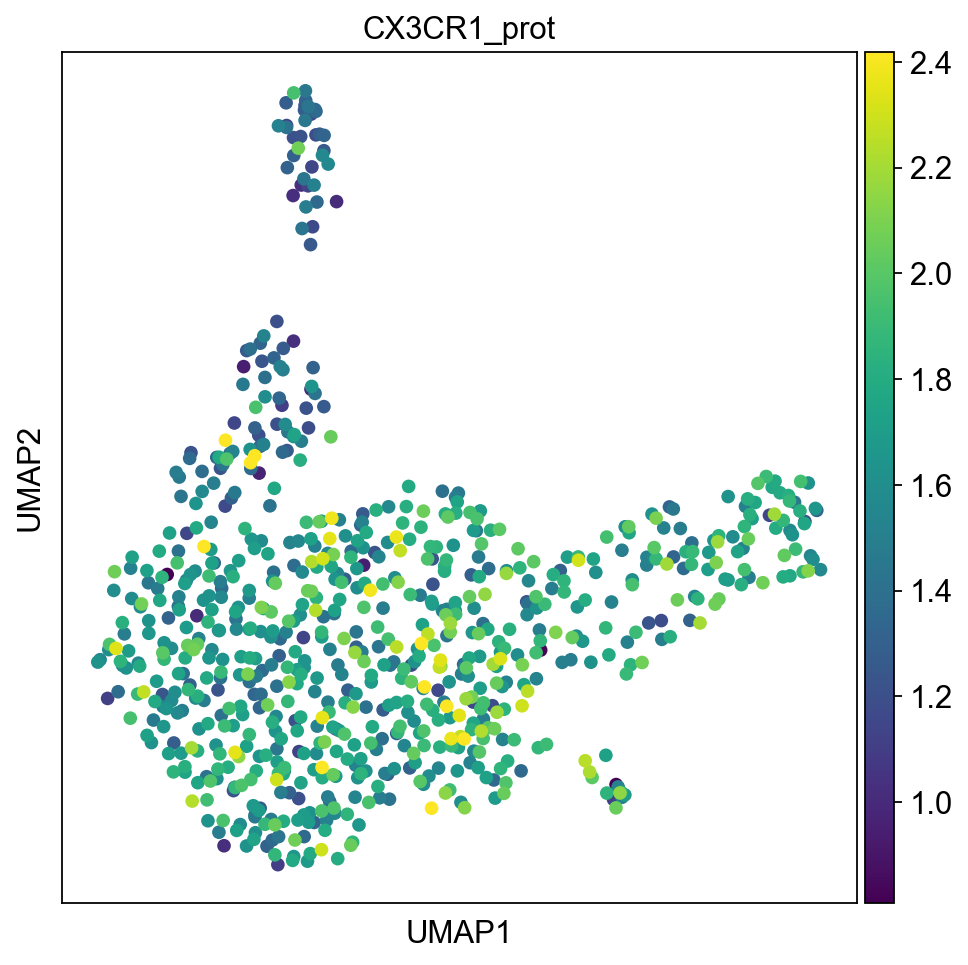

In [166]:
terminal_rna = ['ZEB2', 'CX3CR1', 'HAVCR2' ]
terminal_prot = ['CX3CR1_prot']
    
# (TIM-3). 

#terminal NKs


sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Terminally differentiated NK cells, RNA")
sc.pl.umap(sample_nk, color = terminal_rna, vmax="p99", color_map = 'viridis', ncols=2)

print("Terminally differentiated NK cells, protein")
sc.pl.umap(sample_nk, color = terminal_prot, vmax="p99", color_map = 'viridis', ncols=2)




## Other testing

In [167]:
gammadelta_sep = ['TRG-AS1', 'TRGC1', 'TRGC2', 'TRGV10', 'TRGV2', 'TRGV3', 'TRGV4', 'TRGV5', 'TRGV7', 'TRGV9']

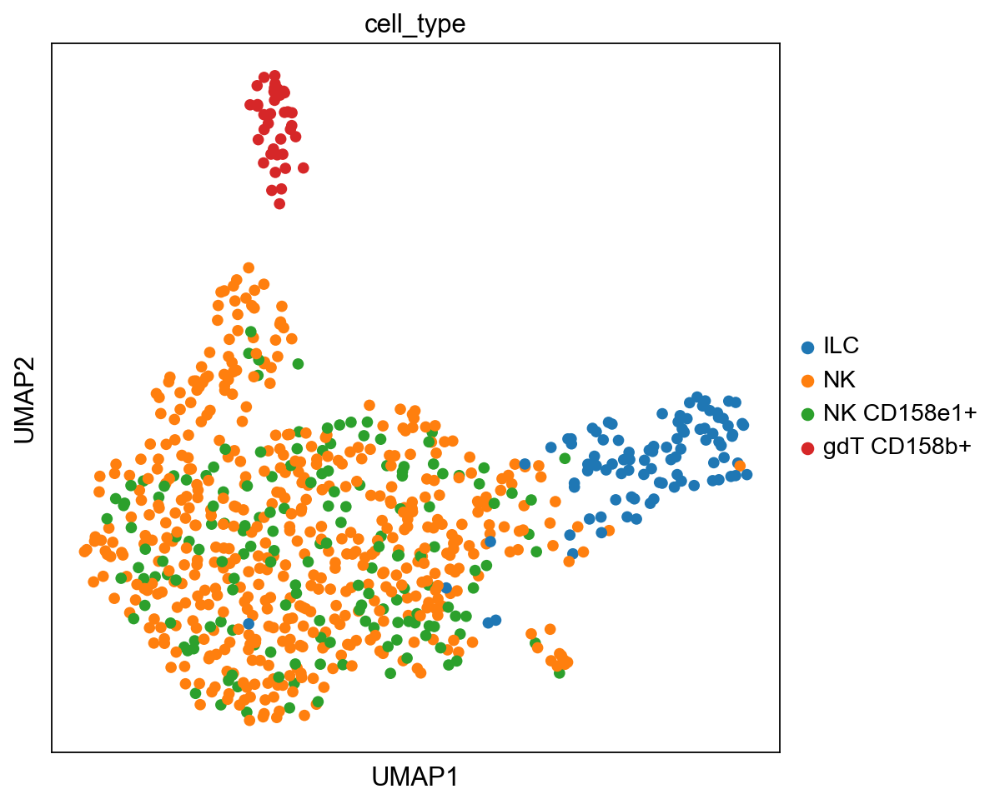

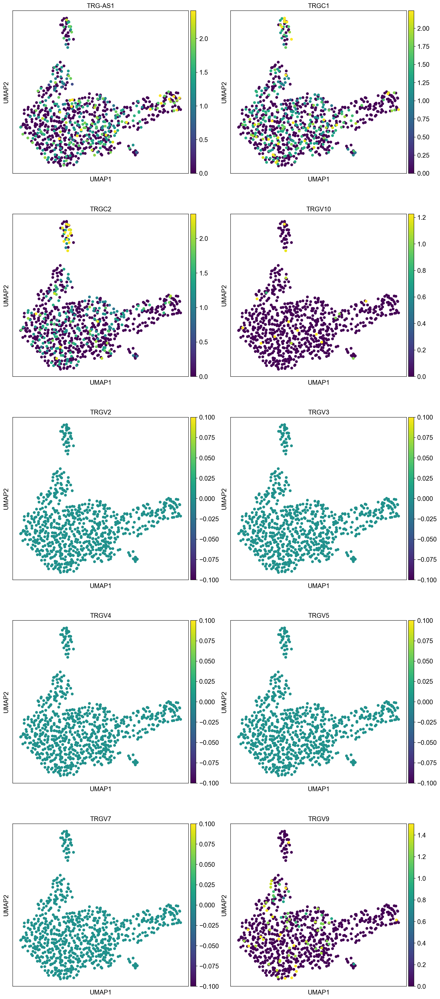

In [168]:
#separation from gamma delta T cells

gammadelta_sep = ['TRG-AS1', 'TRGC1', 'TRGC2', 'TRGV10', 'TRGV2', 'TRGV3', 'TRGV4', 'TRGV5', 'TRGV7', 'TRGV9']

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

sc.pl.umap(sample_nk, color = gammadelta_sep, vmax="p99", color_map = 'viridis', ncols=2)

In [169]:
#CLR normalized protein data, Neurips only

#adata = sc.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/healthy_malig_outer_!m.h5ad')

In [56]:
#Checking if gene was measured in particular study

#adata[adata.to_df()['B3GAT1'] != 0].obs.BATCH.unique().tolist()

['Seurat', 'Granja2', 'Manton']

In [170]:
result = [i for i in adata_neurips.var_names if i.startswith('KIR')]
print(result)

['KIR2DL1', 'KIR2DL2', 'KIR2DL3', 'KIR2DL4', 'KIR3DL1', 'KIR3DL2', 'KIR3DX1', 'KIRREL3']


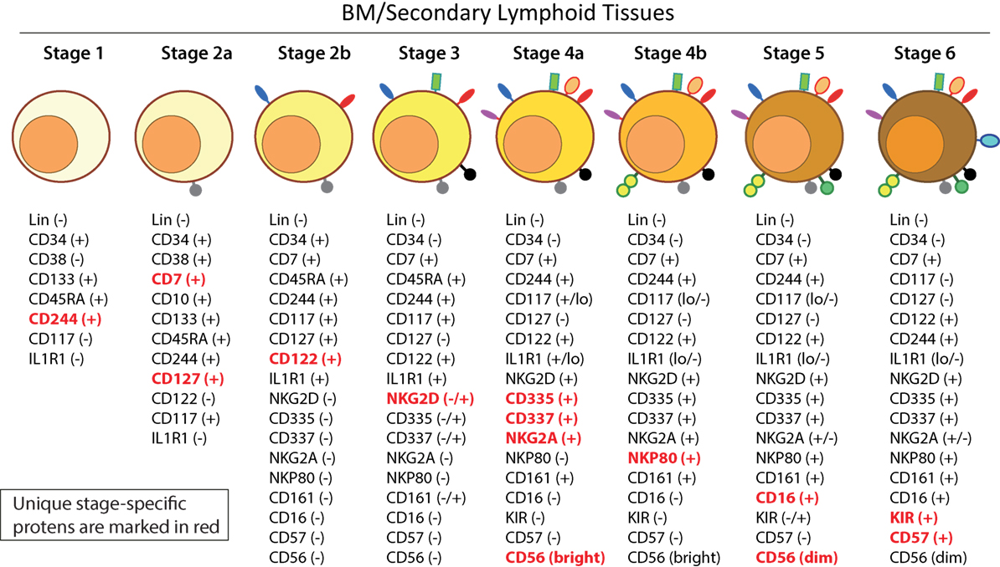

In [171]:
#NKG2A = KLRC1

stage1=["CD224_prot"]
stage2a= ['CD7', 'CD127']
stage2b= ['CD122']
stage3= ["CD314"]
stage4a= ['CD335',"CD56"]
#Stage4b = NKP80 marker not included
stage5= ['CD16']
stage6 = ['CD158e1', 'CD57']


In [172]:
#Used to check which markers were measured


listOfmarkers= ["CD186"]


for x in listOfmarkers:
    if x in prot.columns:
        print("Yes")
        

In [173]:
#If needed, column names can be changes (if gene and prot name same)
prot=prot.rename(columns={'CD224': 'CD224_prot'})

stage 1


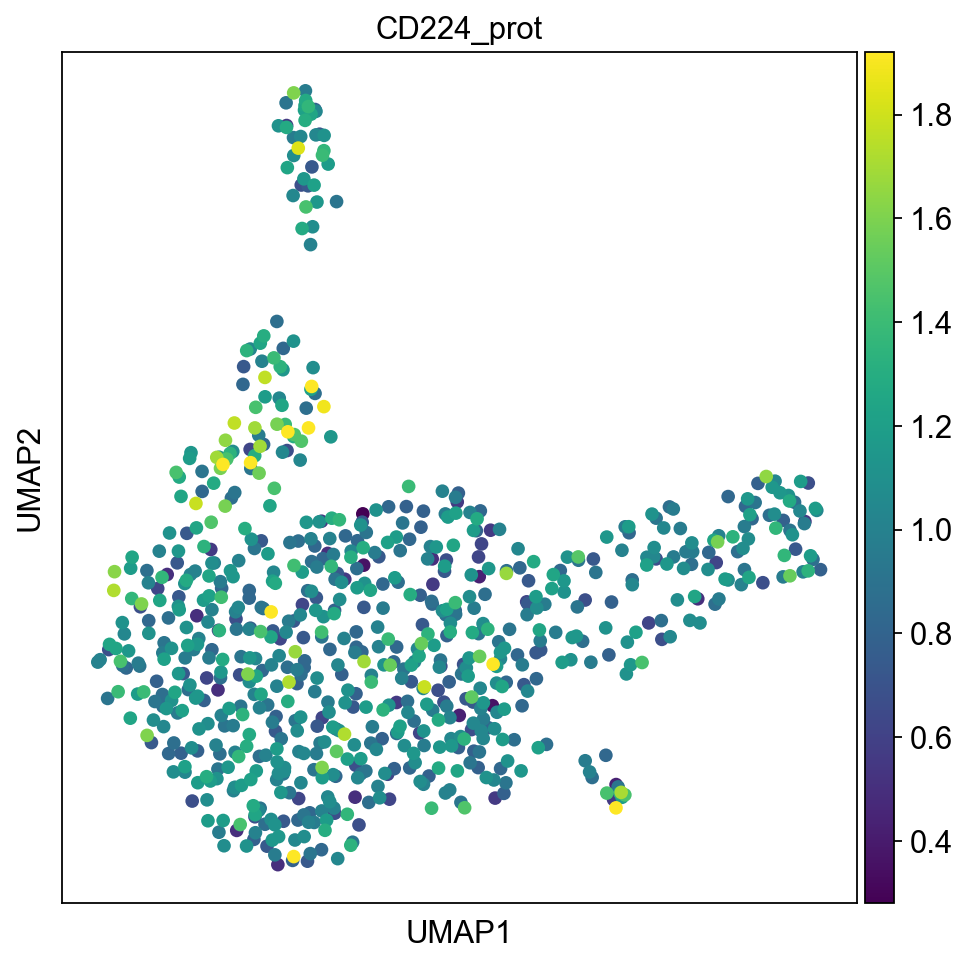

stage 2a


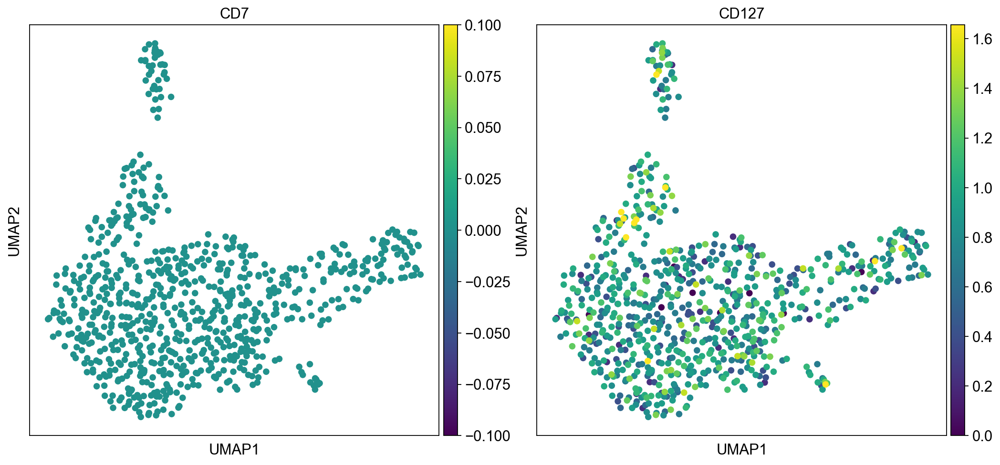

stage 2b


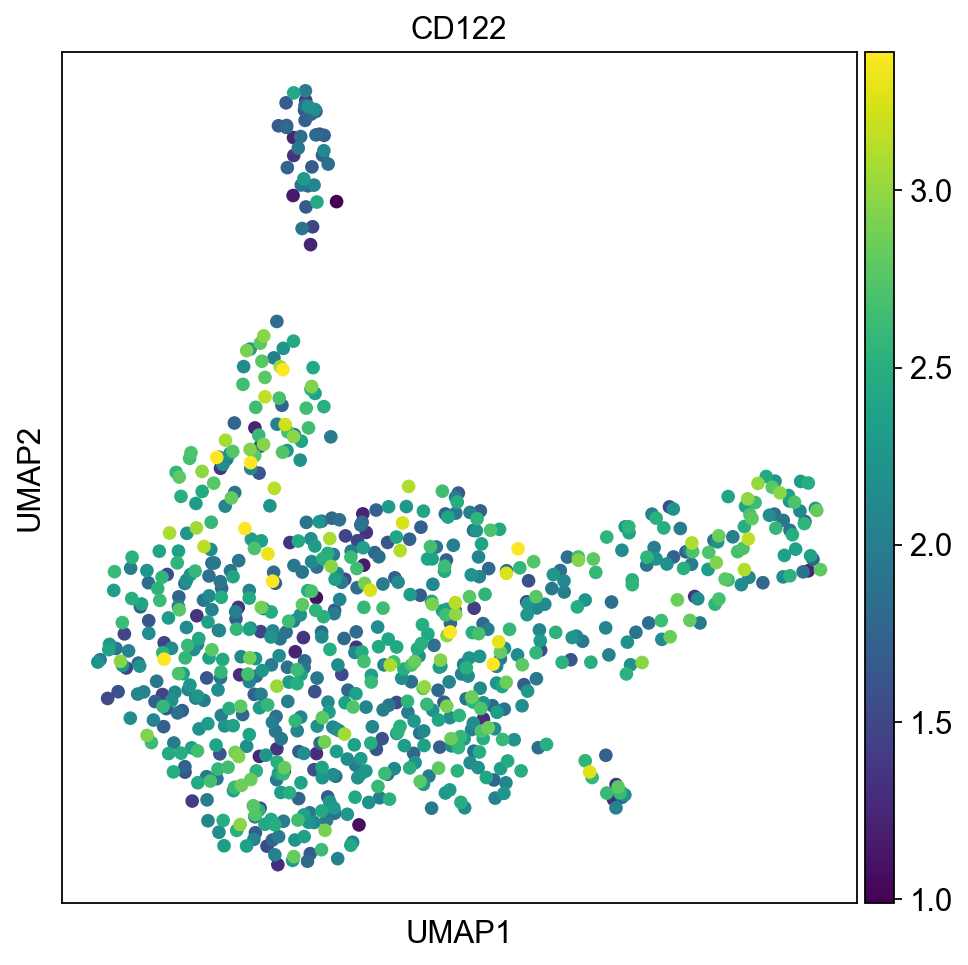

stage 3


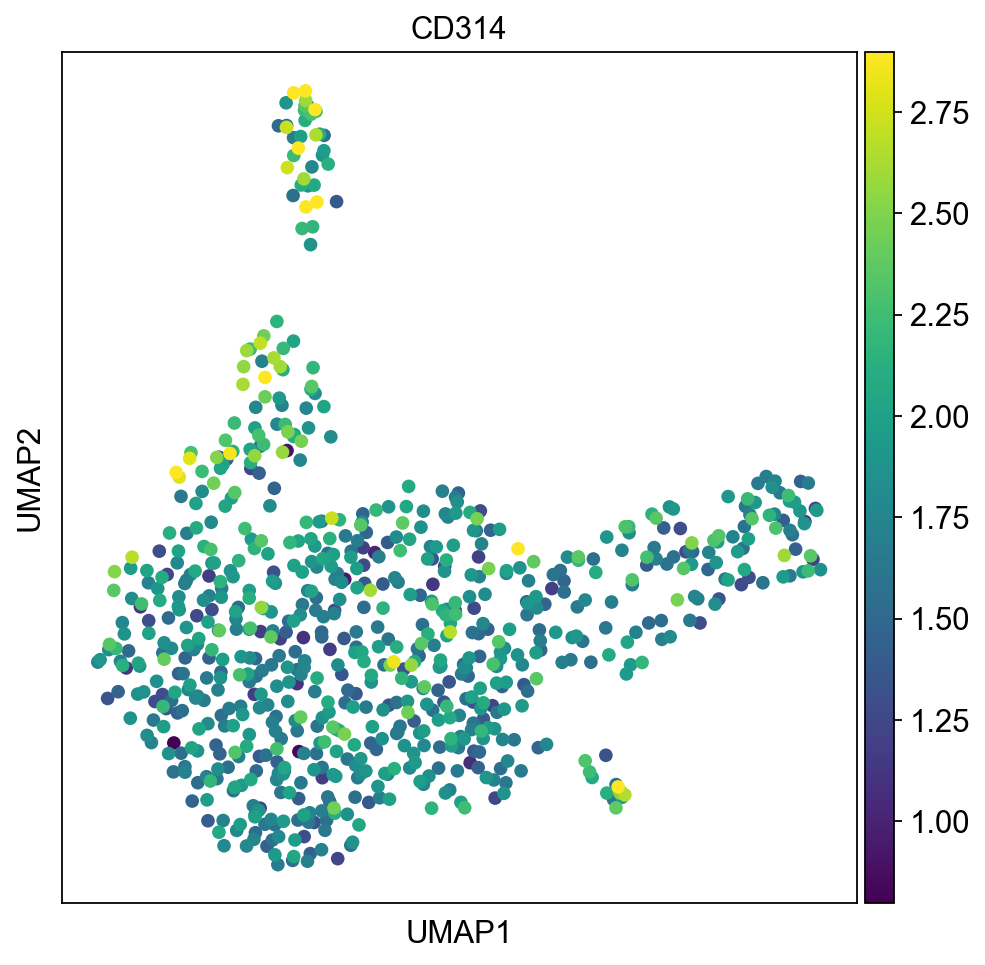

stage 4a, CD56bright


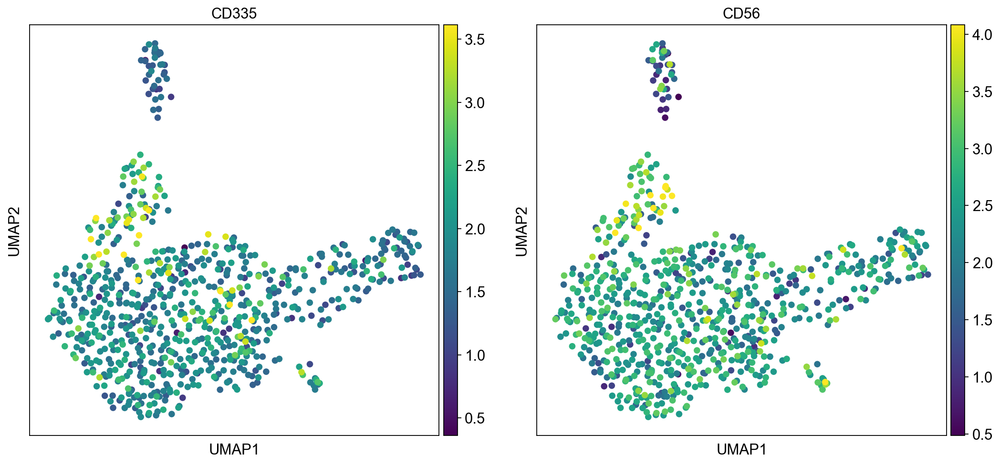

stage 5


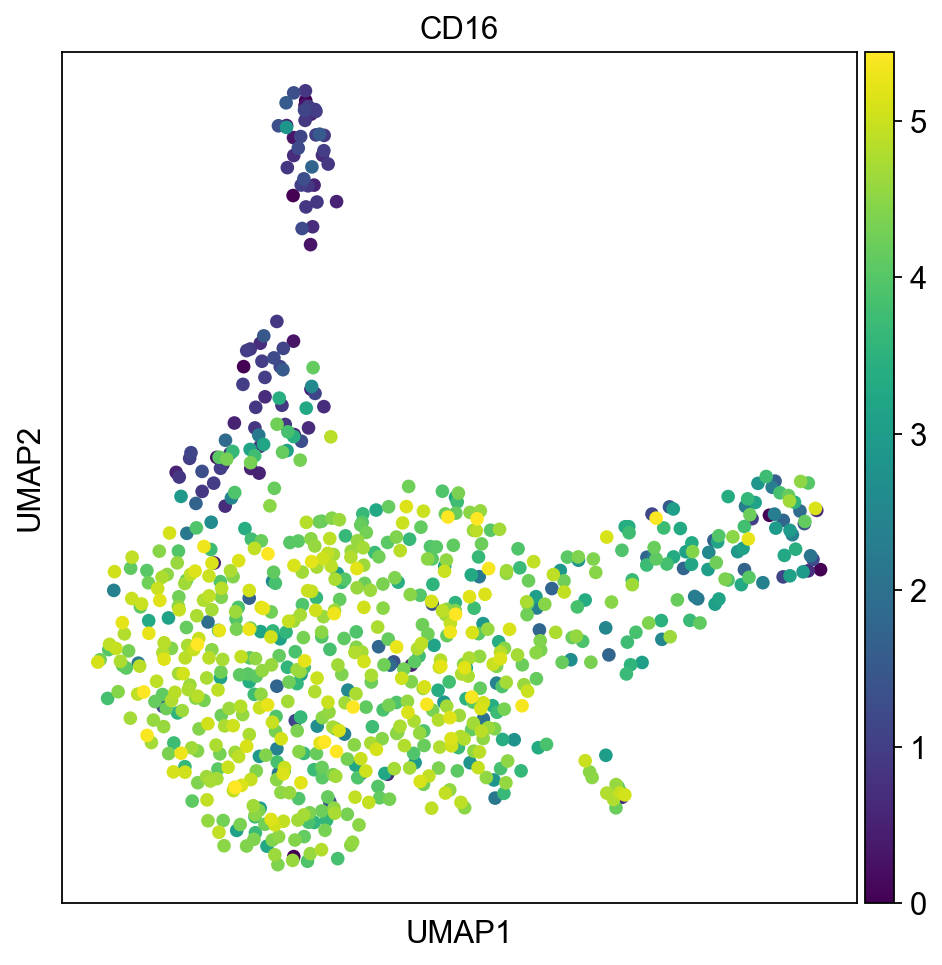

stage 6


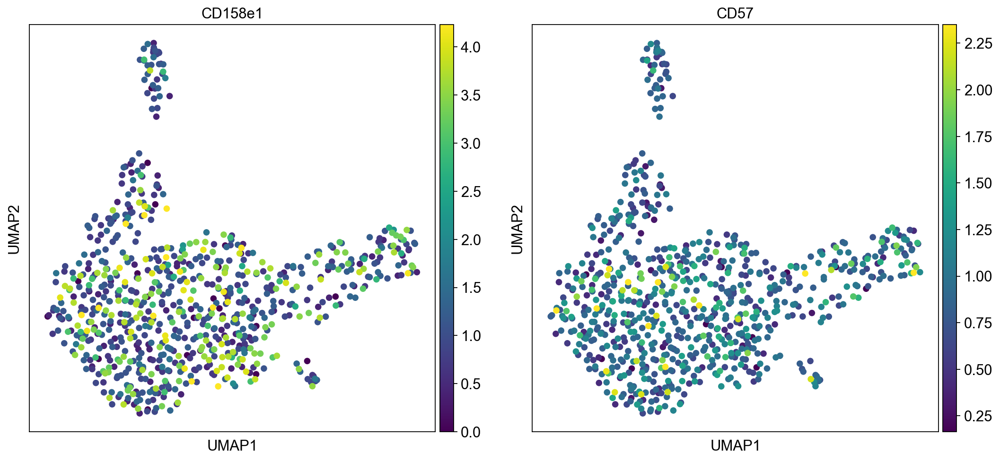

In [174]:
sc.set_figure_params(figsize=(7, 7))

#stage 1
print("stage 1")
sc.pl.umap(sample_nk, color = stage1, vmax="p99", color_map = 'viridis', ncols=2)

#stage 2a
print("stage 2a")
sc.pl.umap(sample_nk, color = stage2a, vmax="p99", color_map = 'viridis', ncols=2)

#stage 2b
print("stage 2b")
sc.pl.umap(sample_nk, color = stage2b, vmax="p99", color_map = 'viridis', ncols=2)

#stage 3
print("stage 3")
sc.pl.umap(sample_nk, color = stage3, vmax="p99", color_map = 'viridis', ncols=2)

#stage 4a
print("stage 4a, CD56bright")
sc.pl.umap(sample_nk, color = stage4a, vmax="p99", color_map = 'viridis', ncols=2)

#stage 5
print("stage 5")
sc.pl.umap(sample_nk, color = stage5, vmax="p99", color_map = 'viridis', ncols=2)

#stage 6
print("stage 6")
sc.pl.umap(sample_nk, color = stage6, vmax="p99", color_map = 'viridis', ncols=2)




stage 1


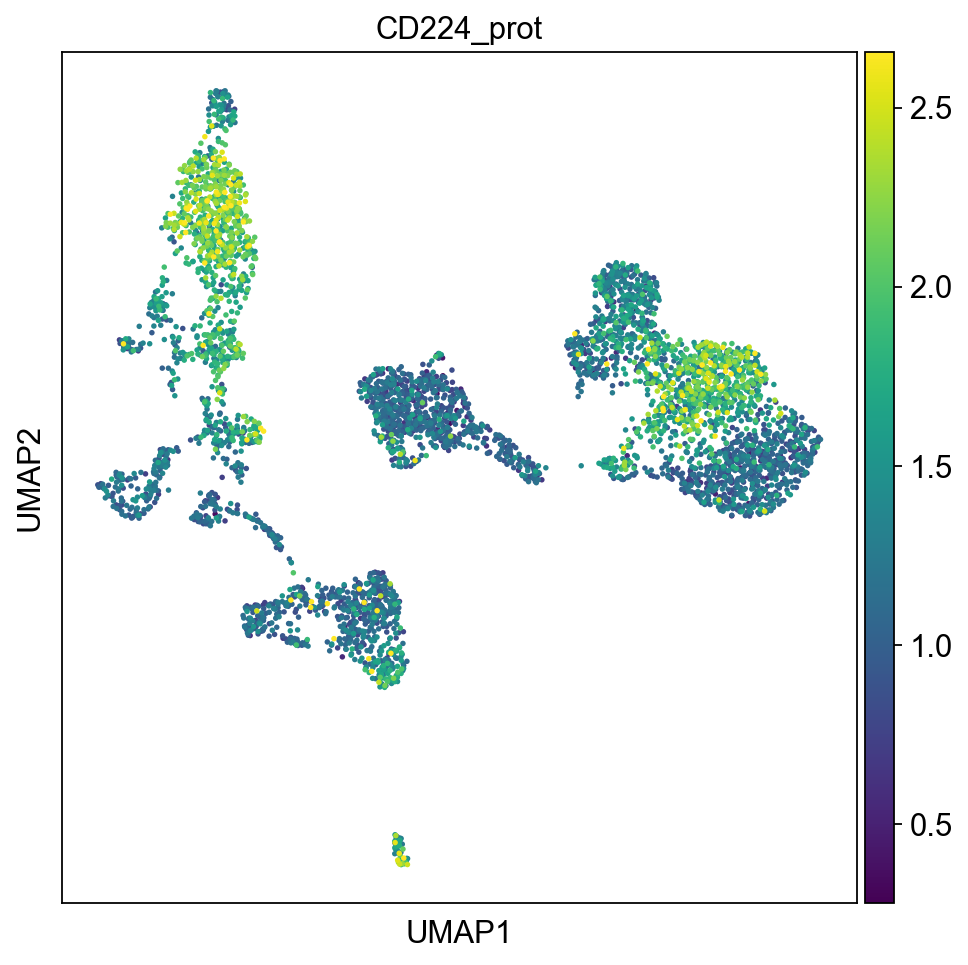

stage 2a


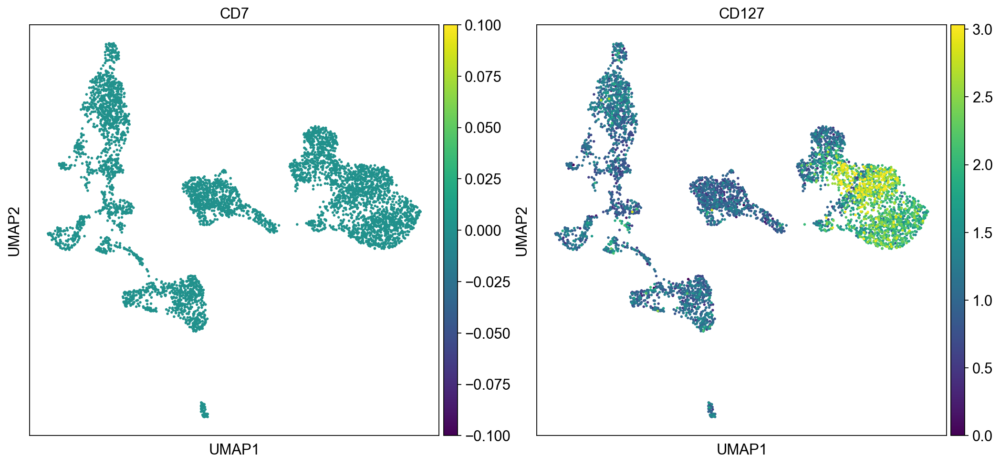

stage 2b


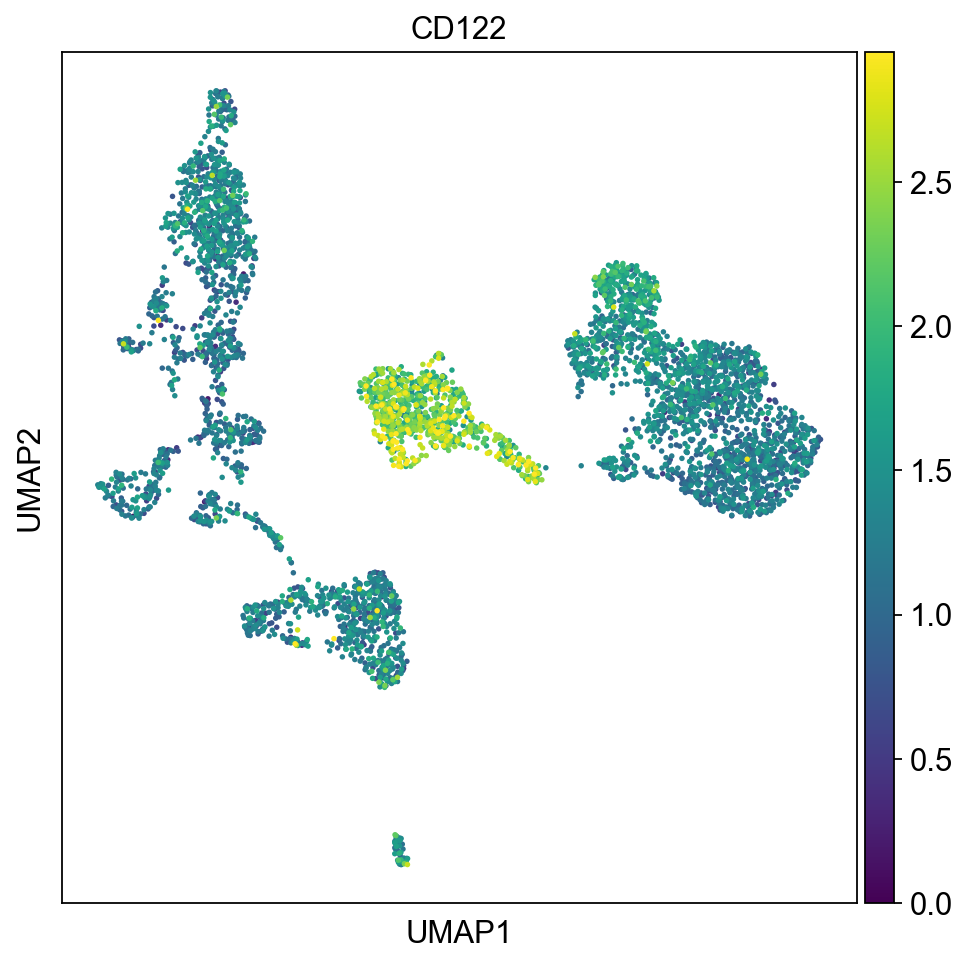

stage 3


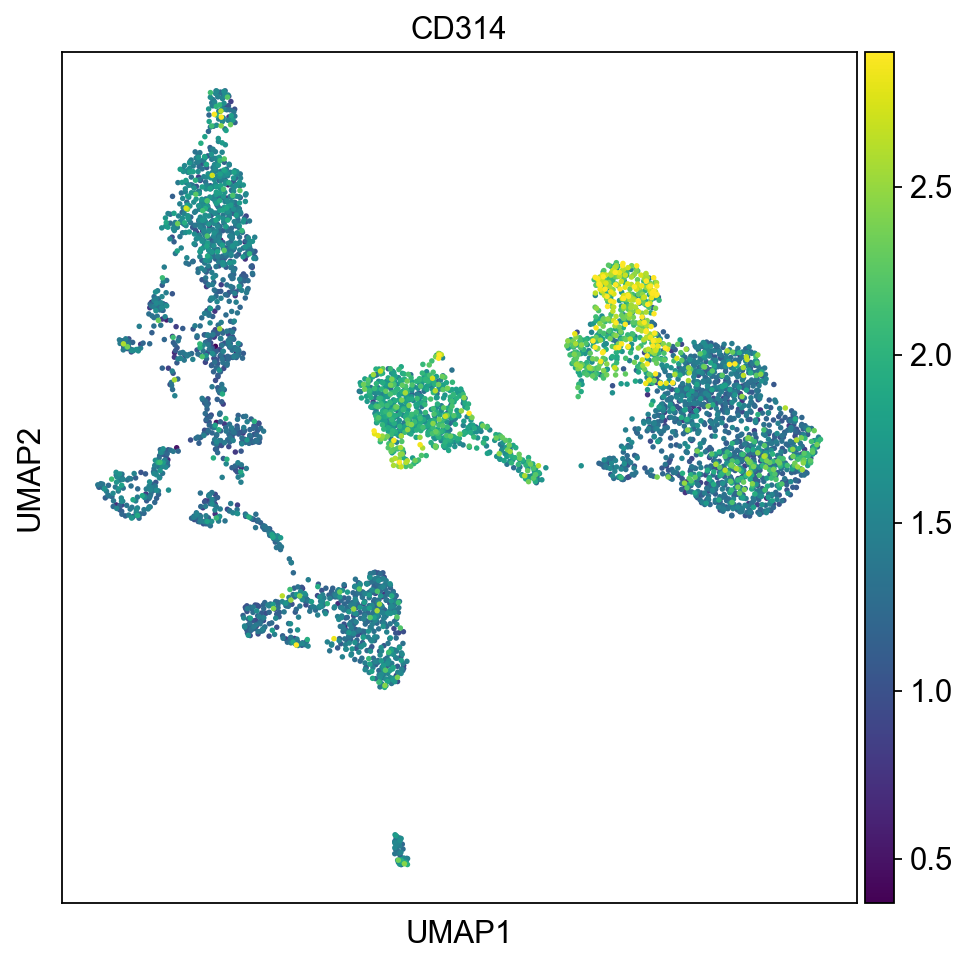

stage 4a, CD56bright


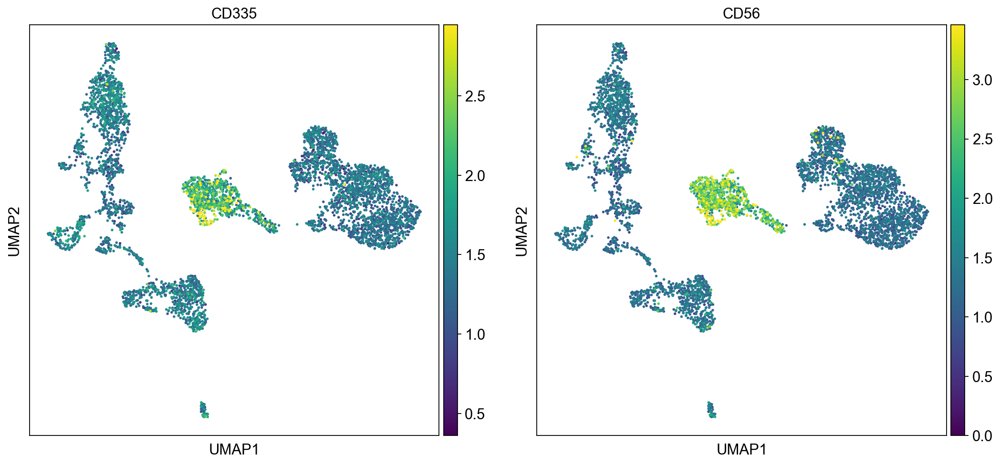

stage 5


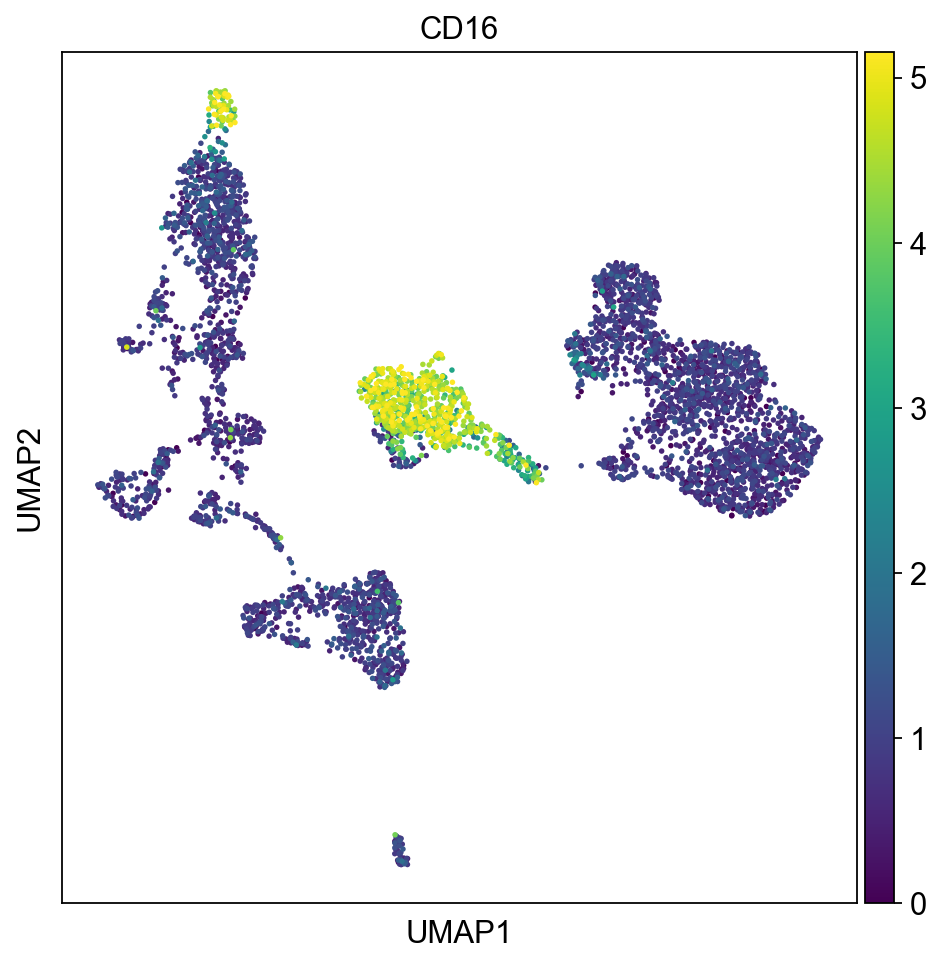

stage 6


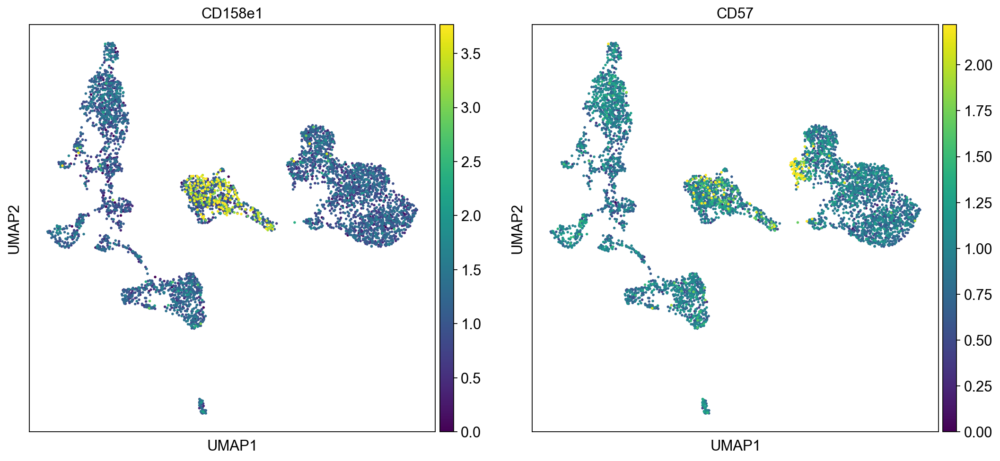

In [177]:
sc.set_figure_params(figsize=(7, 7))

#stage 1
print("stage 1")
sc.pl.umap(eg, color = stage1, vmax="p99", color_map = 'viridis', ncols=2)

#stage 2a
print("stage 2a")
sc.pl.umap(eg, color = stage2a, vmax="p99", color_map = 'viridis', ncols=2)

#stage 2b
print("stage 2b")
sc.pl.umap(eg, color = stage2b, vmax="p99", color_map = 'viridis', ncols=2)

#stage 3
print("stage 3")
sc.pl.umap(eg, color = stage3, vmax="p99", color_map = 'viridis', ncols=2)

#stage 4a
print("stage 4a, CD56bright")
sc.pl.umap(eg, color = stage4a, vmax="p99", color_map = 'viridis', ncols=2)

#stage 5
print("stage 5")
sc.pl.umap(eg, color = stage5, vmax="p99", color_map = 'viridis', ncols=2)

#stage 6
print("stage 6")
sc.pl.umap(eg, color = stage6, vmax="p99", color_map = 'viridis', ncols=2)


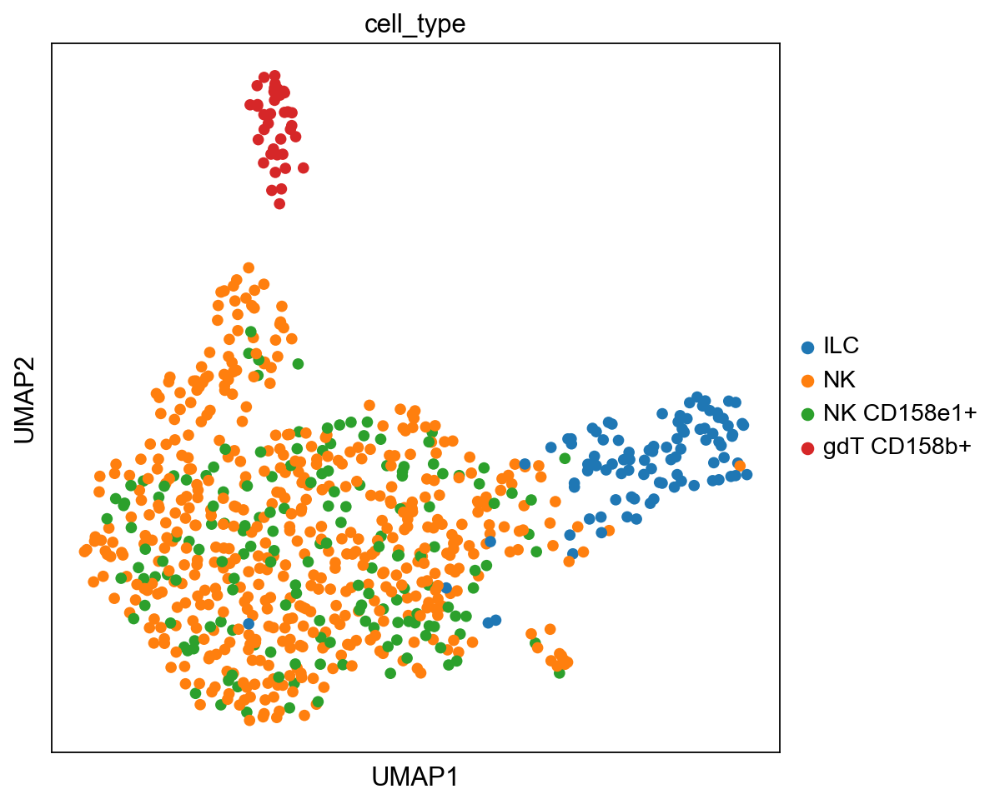

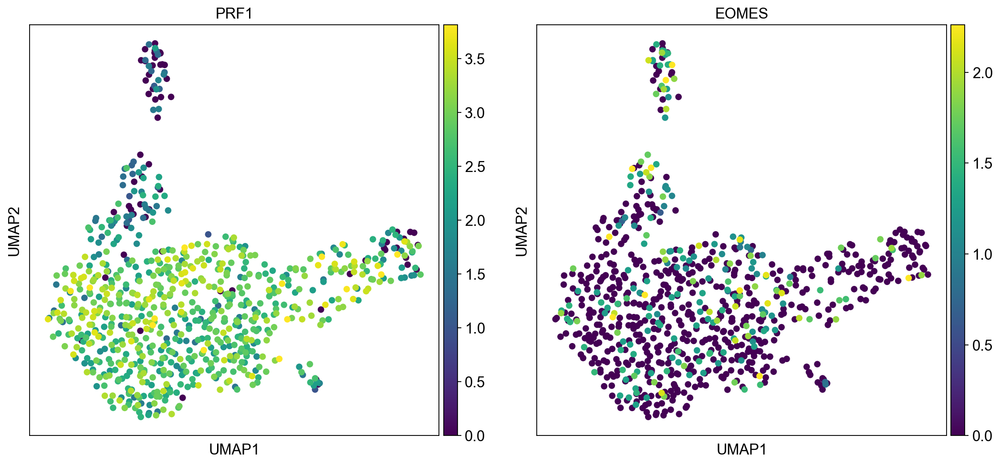

In [175]:
#Separation from ILCs

ilc_sep = ['PRF1', 'EOMES']

#separation from ILCs

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

sc.pl.umap(sample_nk, color = ilc_sep, vmax="p99", color_map = 'viridis', ncols=2)

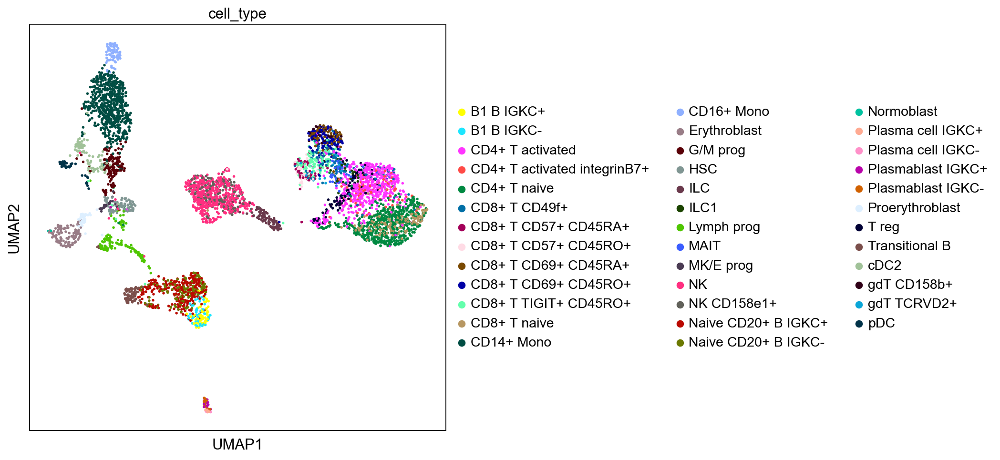

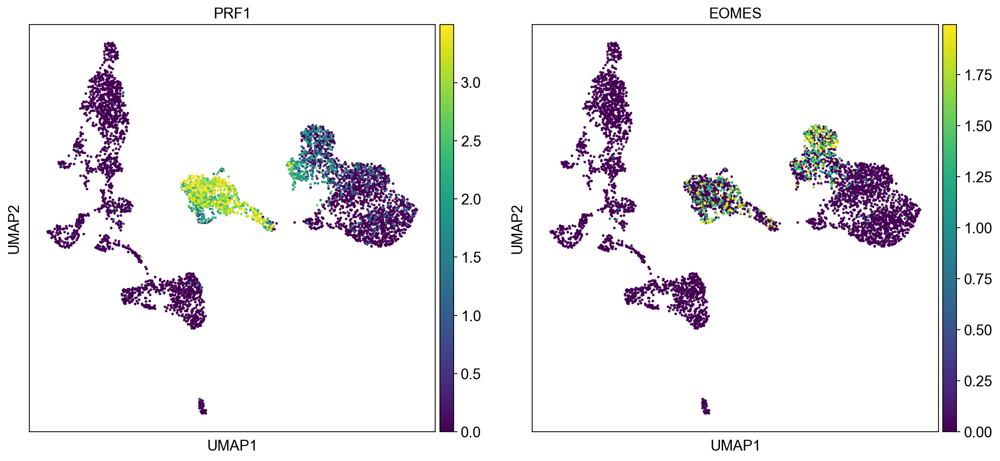

In [176]:
# All cell types

#Separation from ILCs

ilc_sep = ['PRF1', 'EOMES']

#separation from ILCs

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

sc.pl.umap(eg, color = ilc_sep, vmax="p99", color_map = 'viridis', ncols=2)